In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler 
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.mixture import GaussianMixture
import seaborn as sns
from sklearn import metrics
from mlxtend.preprocessing import TransactionEncoder
import warnings
from sklearn.decomposition import PCA

warnings.filterwarnings("ignore")

In [ ]:
netflix = pd.read_csv('netflix_titles.csv')
netflix.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
1,s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
2,s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
3,s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
4,s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...


In [ ]:
netflix.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8807 entries, 0 to 8806
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       8807 non-null   object
 1   type          8807 non-null   object
 2   title         8807 non-null   object
 3   director      6173 non-null   object
 4   cast          7982 non-null   object
 5   country       7976 non-null   object
 6   date_added    8797 non-null   object
 7   release_year  8807 non-null   int64 
 8   rating        8803 non-null   object
 9   duration      8804 non-null   object
 10  listed_in     8807 non-null   object
 11  description   8807 non-null   object
dtypes: int64(1), object(11)
memory usage: 825.8+ KB


In [ ]:
netflix['type'].unique()

array(['Movie', 'TV Show'], dtype=object)

In [ ]:
netflix.drop(netflix.loc[netflix['type'] == 'TV Show'].index, inplace=True)
netflix['type'].unique()

array(['Movie'], dtype=object)

In [ ]:
netflix.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6131 entries, 0 to 8806
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       6131 non-null   object
 1   type          6131 non-null   object
 2   title         6131 non-null   object
 3   director      5943 non-null   object
 4   cast          5656 non-null   object
 5   country       5691 non-null   object
 6   date_added    6131 non-null   object
 7   release_year  6131 non-null   int64 
 8   rating        6129 non-null   object
 9   duration      6128 non-null   object
 10  listed_in     6131 non-null   object
 11  description   6131 non-null   object
dtypes: int64(1), object(11)
memory usage: 622.7+ KB


In [ ]:
netflixm = netflix.drop(columns = ['date_added', 'show_id', 'type', 'duration'])

In [ ]:
netflixm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6131 entries, 0 to 8806
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   title         6131 non-null   object
 1   director      5943 non-null   object
 2   cast          5656 non-null   object
 3   country       5691 non-null   object
 4   release_year  6131 non-null   int64 
 5   rating        6129 non-null   object
 6   listed_in     6131 non-null   object
 7   description   6131 non-null   object
dtypes: int64(1), object(7)
memory usage: 431.1+ KB


In [ ]:
netflixm.isna().sum()

title             0
director        188
cast            475
country         440
release_year      0
rating            2
listed_in         0
description       0
dtype: int64

In [ ]:
netflixm['director'].fillna('', inplace=True)
netflixm['cast'].fillna('', inplace=True)
netflixm['country'].fillna('', inplace=True)
netflixm['rating'].fillna('', inplace=True)

In [ ]:
netflixm.isna().sum()

title           0
director        0
cast            0
country         0
release_year    0
rating          0
listed_in       0
description     0
dtype: int64

In [ ]:
(netflixm == '').sum()

title             0
director        188
cast            475
country         440
release_year      0
rating            2
listed_in         0
description       0
dtype: int64

In [ ]:
netflixm = netflixm[(netflixm[['director', 'cast', 'country']].values == '').sum(axis=1) < 3]

In [ ]:
(netflixm == '').sum()

title             0
director        171
cast            458
country         423
release_year      0
rating            2
listed_in         0
description       0
dtype: int64

In [ ]:
netflixm.head()

,title,director,cast,country,release_year,rating,listed_in,description
0,Dick Johnson Is Dead,Kirsten Johnson,,United States,2020,PG-13,Documentaries,"As her father nears the end of his life, filmm..."
6,My Little Pony: A New Generation,"Robert Cullen, José Luis Ucha","Vanessa Hudgens, Kimiko Glenn, James Marsden, ...",,2021,PG,Children & Family Movies,Equestria's divided. But a bright-eyed hero be...
7,Sankofa,Haile Gerima,"Kofi Ghanaba, Oyafunmike Ogunlano, Alexandra D...","United States, Ghana, Burkina Faso, United Kin...",1993,TV-MA,"Dramas, Independent Movies, International Movies","On a photo shoot in Ghana, an American model s..."
9,The Starling,Theodore Melfi,"Melissa McCarthy, Chris O'Dowd, Kevin Kline, T...",United States,2021,PG-13,"Comedies, Dramas",A woman adjusting to life after a loss contend...
12,Je Suis Karl,Christian Schwochow,"Luna Wedler, Jannis Niewöhner, Milan Peschel, ...","Germany, Czech Republic",2021,TV-MA,"Dramas, International Movies",After most of her family is murdered in a terr...


In [ ]:
netflixm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 8806
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   title         6114 non-null   object
 1   director      6114 non-null   object
 2   cast          6114 non-null   object
 3   country       6114 non-null   object
 4   release_year  6114 non-null   int64 
 5   rating        6114 non-null   object
 6   listed_in     6114 non-null   object
 7   description   6114 non-null   object
dtypes: int64(1), object(7)
memory usage: 429.9+ KB


In [ ]:
netflixm.nunique(axis=0)

title           6114
director        4355
cast            5446
country          652
release_year      73
rating            18
listed_in        277
description     6091
dtype: int64

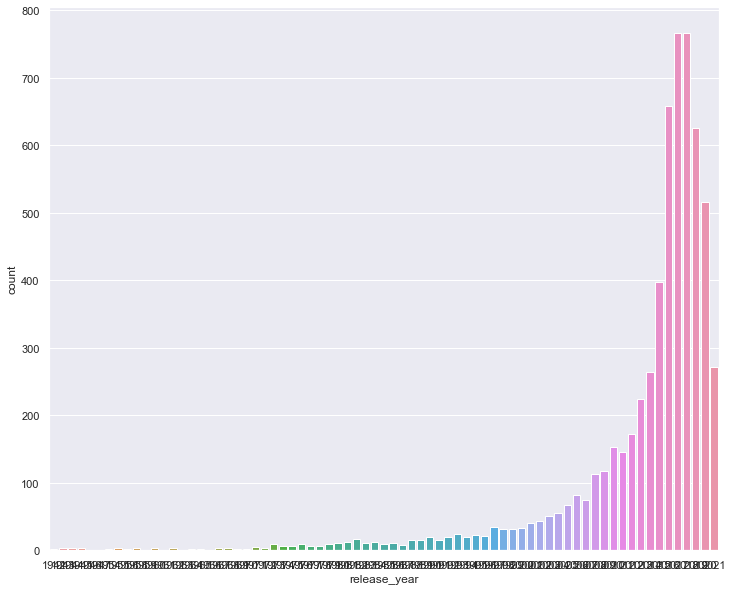

In [ ]:
plt.figure(figsize=(12,10))
sns.set(style="darkgrid")
ax = sns.countplot(x="release_year", data=netflixm, order=netflixm['release_year'].value_counts().index[0:].sort_values(ascending=True))

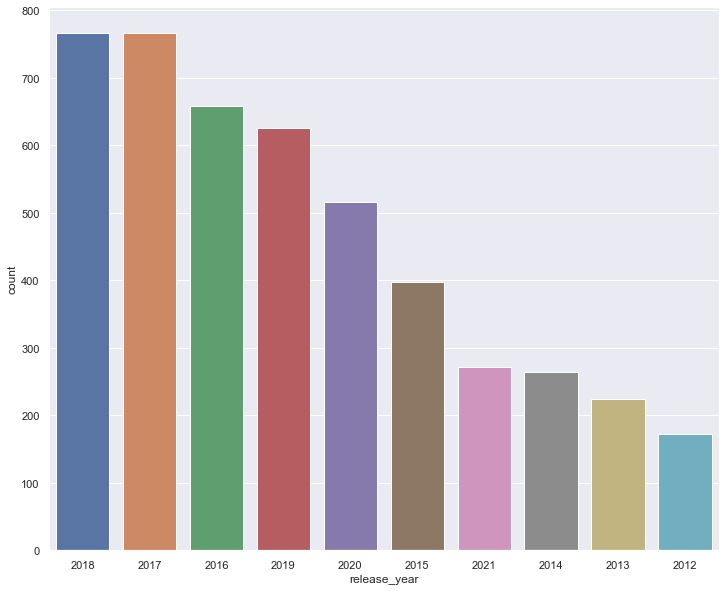

In [ ]:
plt.figure(figsize=(12,10))
sns.set(style="darkgrid")
ax = sns.countplot(x="release_year", data=netflixm, order=netflixm['release_year'].value_counts().index[0:10])

<AxesSubplot:xlabel='rating', ylabel='count'>

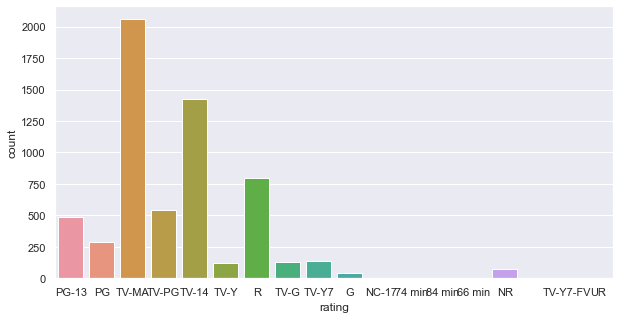

In [ ]:
plt.figure(figsize=(10,5))
sns.countplot(x='rating',data=netflixm)

In [ ]:
netflixm['rating'].unique()

array(['PG-13', 'PG', 'TV-MA', 'TV-PG', 'TV-14', 'TV-Y', 'R', 'TV-G',
       'TV-Y7', 'G', 'NC-17', '74 min', '84 min', '66 min', 'NR', '',
       'TV-Y7-FV', 'UR'], dtype=object)

In [ ]:
netflixm['rating'].value_counts()

TV-MA       2058
TV-14       1423
R            797
TV-PG        539
PG-13        490
PG           286
TV-Y7        138
TV-G         126
TV-Y         125
NR            75
G             41
TV-Y7-FV       5
NC-17          3
UR             3
               2
74 min         1
84 min         1
66 min         1
Name: rating, dtype: int64

In [ ]:
# G : TV-Y7, TV-G, TV-Y, TV-Y7-FV,
# PG-13 : TV-14
# PG : TV-PG
# NR: UR, '', 74 min, 84 min, 66 min
# we're going to consolidate our ratings from 18 different values to 6
replace = {'TV-Y7': 'G',
            'TV-G': 'G', 
            'TV-Y': 'G', 
            'TV-Y7-FV': 'G',
            'TV-14': 'PG-13',
            'TV-PG': 'PG',
            'UR': 'NR',
            '': 'NR',
            '74 min': 'NR', 
            '84 min': 'NR', 
            '66 min': 'NR',
            'NC-17': 'R'}

netflixm['rating'].replace(replace, inplace=True)

<AxesSubplot:xlabel='rating', ylabel='count'>

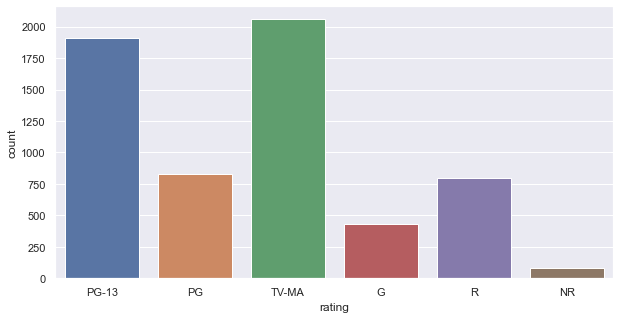

In [ ]:
plt.figure(figsize=(10,5))
sns.countplot(x='rating',data=netflixm)

In [ ]:
# start with country, we're going to give each country its own column, and put a 0 if the country didnt produce the movie and a 1 if it did
country = netflixm.loc[netflixm['country'].notnull(), 'country'].astype('str').apply(lambda t: t.split(','))
country = list(country)
country1 = []
for c in country:
    country1.append([elem.strip() for elem in c])

In [ ]:
country1

[['United States'],
 [''],
 ['United States',
  'Ghana',
  'Burkina Faso',
  'United Kingdom',
  'Germany',
  'Ethiopia'],
 ['United States'],
 ['Germany', 'Czech Republic'],
 [''],
 [''],
 [''],
 [''],
 [''],
 ['India'],
 [''],
 ['United States'],
 ['United States'],
 ['United States', 'India', 'France'],
 [''],
 [''],
 [''],
 ['China', 'Canada', 'United States'],
 ['United States'],
 ['United States'],
 ['United States'],
 ['United States'],
 [''],
 ['South Africa', 'United States', 'Japan'],
 ['United States'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 ['Japan'],
 [''],
 [''],
 [''],
 ['Nigeria'],
 [''],
 [''],
 [''],
 [''],
 [''],
 ['United States'],
 ['Nigeria'],
 [''],
 [''],
 ['Spain', 'United States'],
 ['France'],
 [''],
 ['United Kingdom', 'United States'],
 ['United States'],
 ['United States'],
 [''],
 ['India'],
 ['United States'],
 [''],
 [''],
 ['India'],
 ['United Kingdom', 'Austr

In [ ]:

encoder = TransactionEncoder().fit(country1)
onehot_country = encoder.transform(country1)
#onehot encoder will put false if the country wasnt part of 'country' column, and 1 if it was

onehot_country = pd.DataFrame(onehot_country, columns = encoder.columns_, index=netflixm.loc[netflixm.country.notnull(), 'title'])
pd.set_option('display.max_columns', None)

onehot_country.head()

,,Afghanistan,Albania,Algeria,Angola,Argentina,Armenia,Australia,Austria,Bahamas,Bangladesh,Belgium,Bermuda,Botswana,Brazil,Bulgaria,Burkina Faso,Cambodia,Cameroon,Canada,Cayman Islands,Chile,China,Colombia,Croatia,Czech Republic,Denmark,Dominican Republic,East Germany,Ecuador,Egypt,Ethiopia,Finland,France,Georgia,Germany,Ghana,Greece,Guatemala,Hong Kong,Hungary,Iceland,India,Indonesia,Iran,Iraq,Ireland,Israel,Italy,Jamaica,Japan,Jordan,Kazakhstan,Kenya,Kuwait,Latvia,Lebanon,Liechtenstein,Lithuania,Luxembourg,Malawi,Malaysia,Malta,Mauritius,Mexico,Mongolia,Montenegro,Morocco,Mozambique,Namibia,Nepal,Netherlands,New Zealand,Nicaragua,Nigeria,Norway,Pakistan,Palestine,Panama,Paraguay,Peru,Philippines,Poland,Portugal,Qatar,Romania,Russia,Samoa,Saudi Arabia,Senegal,Serbia,Singapore,Slovakia,Slovenia,Somalia,South Africa,South Korea,Soviet Union,Spain,Sri Lanka,Sudan,Sweden,Switzerland,Syria,Taiwan,Thailand,Turkey,Uganda,Ukraine,United Arab Emirates,United Kingdom,United States,Uruguay,Vatican City,Venezuela,Vietnam,West Germany,Zimbabwe
title,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Dick Johnson Is Dead,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
My Little Pony: A New Generation,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Sankofa,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False
The Starling,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,

In [ ]:
onehot_country

,,Afghanistan,Albania,Algeria,Angola,Argentina,Armenia,Australia,Austria,Bahamas,Bangladesh,Belgium,Bermuda,Botswana,Brazil,Bulgaria,Burkina Faso,Cambodia,Cameroon,Canada,Cayman Islands,Chile,China,Colombia,Croatia,Czech Republic,Denmark,Dominican Republic,East Germany,Ecuador,Egypt,Ethiopia,Finland,France,Georgia,Germany,Ghana,Greece,Guatemala,Hong Kong,Hungary,Iceland,India,Indonesia,Iran,Iraq,Ireland,Israel,Italy,Jamaica,Japan,Jordan,Kazakhstan,Kenya,Kuwait,Latvia,Lebanon,Liechtenstein,Lithuania,Luxembourg,Malawi,Malaysia,Malta,Mauritius,Mexico,Mongolia,Montenegro,Morocco,Mozambique,Namibia,Nepal,Netherlands,New Zealand,Nicaragua,Nigeria,Norway,Pakistan,Palestine,Panama,Paraguay,Peru,Philippines,Poland,Portugal,Qatar,Romania,Russia,Samoa,Saudi Arabia,Senegal,Serbia,Singapore,Slovakia,Slovenia,Somalia,South Africa,South Korea,Soviet Union,Spain,Sri Lanka,Sudan,Sweden,Switzerland,Syria,Taiwan,Thailand,Turkey,Uganda,Ukraine,United Arab Emirates,United Kingdom,United States,Uruguay,Vatican City,Venezuela,Vietnam,West Germany,Zimbabwe
title,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Dick Johnson Is Dead,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
My Little Pony: A New Generation,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Sankofa,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False
The Starling,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,

In [ ]:
country_percentage = onehot_country.mean().sort_values(ascending=False).round(6) * 100
country_percentage

United States         45.0114
India                 15.7344
United Kingdom         8.7341
                       7.0167
Canada                 5.2175
                       ...   
Ecuador                0.0164
Dominican Republic     0.0164
Samoa                  0.0164
Slovakia               0.0164
East Germany           0.0164
Length: 118, dtype: float64

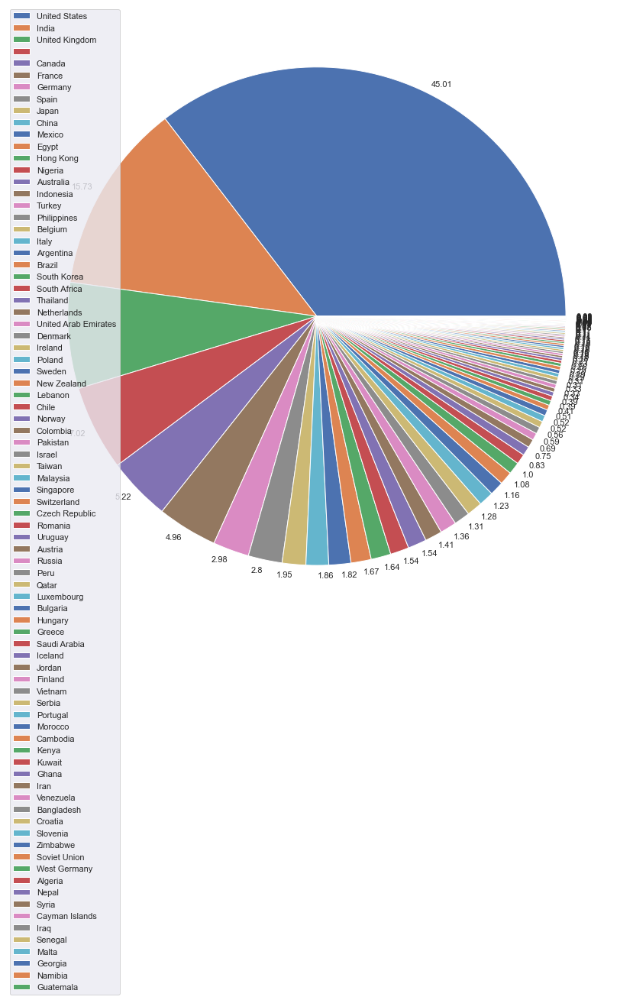

In [ ]:
# lets make a graph for all the countries that make up 1% or more of the countries
country_1 = country_percentage[country_percentage > 0.017]
fig1, ax1 = plt.subplots(figsize=(20,15), facecolor='white')
ax1.pie(country_1, labels = country_1.round(2), labeldistance=1.04)
plt.legend(labels = country_1.index)
plt.show()

In [ ]:
country_list = list(country_percentage)

# lets see how often a country hosts a movie.
frequency = {}
for item in country_list:
    if item in frequency:
        frequency[item] +=1
    else:
        frequency[item] = 1
print(frequency)

# 1 country hosts 45% of the movies, while  35 countries only host 0.0164% of the movies (or just 1 movie).

{45.0114: 1, 15.7344: 1, 8.7341: 1, 7.016699999999999: 1, 5.2175: 1, 4.9558: 1, 2.9768: 1, 2.7969: 1, 1.9464: 1, 1.8646: 1, 1.8155000000000001: 1, 1.6683: 1, 1.6356: 1, 1.5375: 2, 1.4066: 1, 1.3575: 1, 1.3085: 1, 1.2758: 1, 1.2267000000000001: 1, 1.1613: 1, 1.0795000000000001: 1, 0.9977: 1, 0.8342: 1, 0.7524000000000001: 1, 0.6869000000000001: 1, 0.5888: 1, 0.5561: 1, 0.5234: 2, 0.507: 1, 0.4089: 1, 0.39249999999999996: 2, 0.3435: 1, 0.3271: 2, 0.3108: 2, 0.2944: 3, 0.2617: 1, 0.22899999999999998: 1, 0.21259999999999998: 1, 0.1799: 2, 0.1636: 5, 0.1472: 2, 0.1308: 1, 0.11449999999999999: 4, 0.0981: 4, 0.0818: 2, 0.0654: 3, 0.0491: 6, 0.0327: 9, 0.0164: 35}


<AxesSubplot:xlabel='count'>

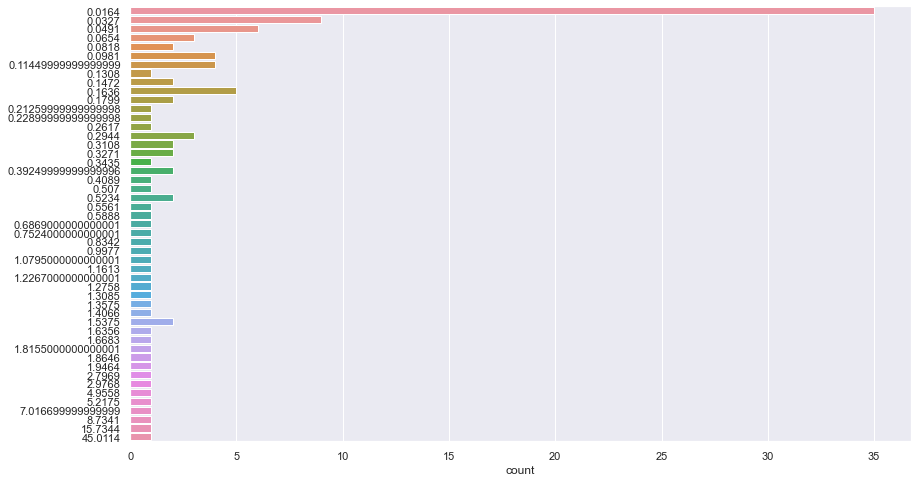

In [ ]:
plt.figure(figsize=(14,8))
sns.countplot(y = country_percentage, data=country_percentage)

In [ ]:
country_1 = country_percentage[country_percentage > 0.017]

# we're going to remove the countries that only appear once. having only 1 datapoint isn't helpful for creating connections
list_of_countries = country_1.index
list_of_countries = list(list_of_countries)

In [ ]:
country_1.info()

<class 'pandas.core.series.Series'>
Index: 83 entries, United States to Guatemala
Series name: None
Non-Null Count  Dtype  
--------------  -----  
83 non-null     float64
dtypes: float64(1)
memory usage: 1.3+ KB


In [ ]:
onehot_country = onehot_country[list_of_countries]

In [ ]:
onehot_country.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Data columns (total 83 columns):
 #   Column                Non-Null Count  Dtype
---  ------                --------------  -----
 0   United States         6114 non-null   bool 
 1   India                 6114 non-null   bool 
 2   United Kingdom        6114 non-null   bool 
 3                         6114 non-null   bool 
 4   Canada                6114 non-null   bool 
 5   France                6114 non-null   bool 
 6   Germany               6114 non-null   bool 
 7   Spain                 6114 non-null   bool 
 8   Japan                 6114 non-null   bool 
 9   China                 6114 non-null   bool 
 10  Mexico                6114 non-null   bool 
 11  Egypt                 6114 non-null   bool 
 12  Hong Kong             6114 non-null   bool 
 13  Nigeria               6114 non-null   bool 
 14  Australia             6114 non-null   bool 
 15  Indonesia             6114 non-null   b

In [ ]:
# we lowered the number of columns to countries that were at least in 2 movies
onehot_country.head()

,United States,India,United Kingdom,,Canada,France,Germany,Spain,Japan,China,Mexico,Egypt,Hong Kong,Nigeria,Australia,Indonesia,Turkey,Philippines,Belgium,Italy,Argentina,Brazil,South Korea,South Africa,Thailand,Netherlands,United Arab Emirates,Denmark,Ireland,Poland,Sweden,New Zealand,Lebanon,Chile,Norway,Colombia,Pakistan,Israel,Taiwan,Malaysia,Singapore,Switzerland,Czech Republic,Romania,Uruguay,Austria,Russia,Peru,Qatar,Luxembourg,Bulgaria,Hungary,Greece,Saudi Arabia,Iceland,Jordan,Finland,Vietnam,Serbia,Portugal,Morocco,Cambodia,Kenya,Kuwait,Ghana,Iran,Venezuela,Bangladesh,Croatia,Slovenia,Zimbabwe,Soviet Union,West Germany,Algeria,Nepal,Syria,Cayman Islands,Iraq,Senegal,Malta,Georgia,Namibia,Guatemala
title,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Dick Johnson Is Dead,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
My Little Pony: A New Generation,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Sankofa,True,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
The Starling,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Je Suis Karl,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
cast = netflixm.loc[netflixm['cast'].notnull(), 'cast'].astype('str').apply(lambda t: t.split(', '))
cast = list(cast)

encoder = TransactionEncoder().fit(cast)
onehot_cast = encoder.transform(cast)

onehot_cast = pd.DataFrame(onehot_cast, columns = encoder.columns_, index=netflixm.loc[netflixm.cast.notnull(), 'title'])

cast_total = onehot_cast.sum().sort_values(ascending=False)

In [ ]:
onehot_cast.info

<bound method DataFrame.info of                                            Jr.  "Riley" Lakdhar Dridi  \
title                                                                   
Dick Johnson Is Dead               True  False                  False   
My Little Pony: A New Generation  False  False                  False   
Sankofa                           False  False                  False   
The Starling                      False  False                  False   
Je Suis Karl                      False  False                  False   
...                                 ...    ...                    ...   
Zinzana                           False  False                  False   
Zodiac                            False  False                  False   
Zombieland                        False  False                  False   
Zoom                              False  False                  False   
Zubaan                            False  False                  False   

                  

In [ ]:
cast_percentage = onehot_cast.mean().sort_values(ascending=False).round(8) * 100
cast_percentage

                    7.491004
Anupam Kher         0.686948
Shah Rukh Khan      0.572457
Naseeruddin Shah    0.523389
Akshay Kumar        0.490677
                      ...   
Jacob Bertrand      0.016356
Jacob Batalon       0.016356
Jacob Artist        0.016356
Jaco Muller         0.016356
Ṣọpẹ́ Dìrísù        0.016356
Length: 25952, dtype: float64

In [ ]:
cast_list = list(cast_percentage)

In [ ]:
frequency = {}
for item in cast_list:
    if item in frequency:
        frequency[item] +=1
    else:
        frequency[item] = 1
print(frequency)

{7.491003999999999: 1, 0.686948: 1, 0.572457: 1, 0.523389: 1, 0.49067700000000003: 2, 0.457965: 3, 0.44160900000000003: 2, 0.408898: 1, 0.35983: 1, 0.343474: 2, 0.32711799999999996: 5, 0.31076200000000004: 4, 0.294406: 2, 0.27805: 7, 0.261694: 14, 0.24533900000000003: 12, 0.22898300000000002: 20, 0.212627: 35, 0.196271: 24, 0.179915: 59, 0.16355899999999998: 75, 0.147203: 113, 0.130847: 153, 0.11449100000000001: 201, 0.098135: 248, 0.08178: 483, 0.06542400000000001: 784, 0.049067999999999994: 1469, 0.032712000000000005: 3597, 0.016356000000000002: 18632}


In [ ]:
# we're going to drop 18832 casts from our list, these are cast memembers that only appeared in one movie
short_cast = cast_percentage[cast_percentage > 0.03]
short_cast


                      7.491004
Anupam Kher           0.686948
Shah Rukh Khan        0.572457
Naseeruddin Shah      0.523389
Akshay Kumar          0.490677
                        ...   
Sheetal Thakur        0.032712
Shayan Munshi         0.032712
Courtney Halverson    0.032712
Shamaine Centenera    0.032712
Shiviske Shivisi      0.032712
Length: 7320, dtype: float64

In [ ]:
list_of_cast = short_cast.index
list_of_cast = list(list_of_cast)
onehot_cast = onehot_cast[list_of_cast]

In [ ]:
onehot_cast.head()

,,Anupam Kher,Shah Rukh Khan,Naseeruddin Shah,Akshay Kumar,Om Puri,Paresh Rawal,Amitabh Bachchan,Julie Tejwani,Boman Irani,Rupa Bhimani,Kareena Kapoor,Samuel L. Jackson,Ajay Devgn,Rajesh Kava,Nawazuddin Siddiqui,Adam Sandler,Salman Khan,Nicolas Cage,Kay Kay Menon,Gulshan Grover,James Franco,Jigna Bhardwaj,John Cleese,Yashpal Sharma,Anil Kapoor,Andrea Libman,Fred Tatasciore,Rajpal Yadav,David Spade,Bruce Willis,Jackie Shroff,Asrani,Morgan Freeman,Vatsal Dubey,Manoj Joshi,Vijay Raaz,Danny Trejo,Priyanka Chopra,Hassan Hosny,Kristen Stewart,Sanjay Mishra,Tinnu Anand,Rajesh Sharma,Aamir Khan,Amrish Puri,Saif Ali Khan,Blossom Chukwujekwu,Tara Strong,Toyin Abraham,Manoj Bajpayee,Mike Epps,Fred Armisen,Molly Shannon,Sanjay Dutt,Seth Rogen,Alfred Molina,Maya Rudolph,Willem Dafoe,Adil Hussain,Kulbhushan Kharbanda,Katrina Kaif,Pavan Malhotra,Ben Kingsley,Pankaj Tripathi,Laura Bailey,John Abraham,Sachin Khedekar,Johnny Depp,Shakti Kapoor,Erin Fitzgerald,Ramsey Nouah,Michael Peña,Laurence Fishburne,Demet Akbağ,Rajkummar Rao,Liam Neeson,Sharat Saxena,Pierce Brosnan,Debi Derryberry,Woody Harrelson,John Travolta,Mohnish Bahl,Rishi Kapoor,Stanley Tucci,Richard Mofe-Damijo,Abhishek Bachchan,Amy Adams,Tina Mba,Fortune Feimster,Brendan Gleeson,Nana Patekar,Mousam,Vincent Tong,Helen Mirren,Radhika Apte,Swapnil,Ranvir Shorey,Guy Pearce,Shaffy Bello,Mithun Chakraborty,Kate Higgins,Shahid Kapoor,Ryan Reynolds,Liev Schreiber,Irrfan Khan,John C. Reilly,Chris Rock,Ahmed Helmy,Kevin Hart,Nassar,Vipin Sharma,Ray Liotta,Jackie Chan,Halle Berry,Paul Giamatti,James Marsden,Jeff Dunham,Salma Hayek,Rajit Kapoor,Harrison Ford,Omoni Oboli,Samuel West,Martin Lawrence,Steve Buscemi,Jimmy Shergill,Rob Riggle,Robert Pattinson,Vidya Balan,Antonio Banderas,Robert De Niro,Seema Biswas,Diana Kaarina,Will Ferrell,Saurabh Shukla,Dennis Quaid,Danny McBride,Juhi Chawla,Ben Mendelsohn,Divya Dutta,Konkona Sen Sharma,Rani Mukerji,Kathryn Hahn,Michael Jai White,Dalip Tahil,Mahesh Manjrekar,Robert Patrick,Javed Sheikh,Gerard Butler,Dermot Mulroney,Bruce Greenwood,London Hughes,Alok Nath,Cate Blanchett,Jacki Weaver,Robb Wells,Julianne Moore,Julia Roberts,Satish Shah,Jack Black,Bimbo Manuel,Naomi Watts,David Koechner,Sathyaraj,Amber Heard,Matt Damon,Glenn Close,Anthony Mackie,Tusshar Kapoor,Anton Yelchin,Manisha Koirala,George Clooney,Johny Lever,Jim Broadbent,Joan Cusack,Don Cheadle,Abhay Deol,William H. Macy,Gary Oldman,Ken Jeong,Lucy Liu,Michael Shannon,Sonal Kaushal,John Malkovich,Harvey Keitel,Cindy Robinson,Arjun Rampal,Michael Palin,Raghuvir Yadav,Keanu Reeves,Ron Perlman,Sunil Shetty,B.N. Sharma,John Michael Higgins,Denzel Washington,Jessica Chastain,Danny Glover,Loretta Devine,Ian James Corlett,Vivek Oberoi,Erin Mathews,Amrita Rao,Colin Farrell,Karamjit Anmol,Tamannaah Bhatia,Segun Arinze,Viola Davis,Alan Cumming,Brijendra Kala,Eric Idle,Anna Kendrick,Luke Wilson,Adam Scott,Raj Babbar,Kathryn Bernardo,America Young,Hrithik Roshan,Susan Sarandon,Keith David,Frank Grillo,Maria Bello,Kevin James,Mukesh Tiwari,Prem Chopra,Preity Zinta,Ramya Krishnan,Will Smith,Alessandro Juliani,Alec Baldwin,Yuki Kaji,Sam Shepard,Emile Hirsch,Nick Swardson,Rob Schneider,Michael Madsen,Nicole Kidman,Luis Guzmán,Eddie Murphy,Zoe Saldana,Joke Silva,Johnny Lever,Stephen Lang,Stephen Fry,John Paul Tremblay,Sonam Kapoor,Ricky Gervais,Atul Kulkarni,Arshad Warsi,Ali Nuhu,John Leguizamo,Ashleigh Ball,Sonali Kulkarni,Donnie Yen,Sardar Sohi,Zach Galifianakis,Shraddha Kapoor,Anthony Hopkins,Zakir Hussain,Greg Kinnear,Terrence Howard,Rosario Dawson,Anthony Anderson,Meryl Streep,Steve Coogan,John Carroll Lynch,Neha Dhupia,Supriya Pathak,Laura Linney,Patrick Wilson,Louis Koo,Reza Rahadian,Shreyas Talpade,Randeep Hooda,Christina Hendricks,Cedric the Entertainer,Steve Zahn,Chloë Grace Moretz,Chris Parnell,Lotfy Labib,Frank Langella,Reema Lagoo,George Lopez,Chie Nakamura,Cezmi Baskın,Gurpreet Guggi,Luis Tosar,Richard Jenkins,Govind Namdeo,Tim Blake Nelson,Aishwarya Rai Bachchan,Tony Hale,John Goodman,John Duns

In [ ]:
onehot_cast.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 7320 entries,  to Shiviske Shivisi
dtypes: bool(7320)
memory usage: 42.7+ MB


<AxesSubplot:>

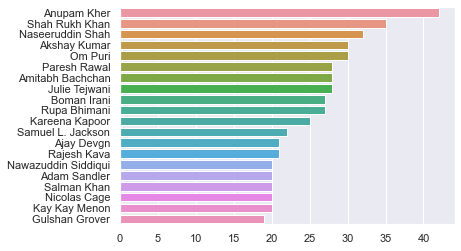

In [ ]:
cast1 = cast_total[1:21]
sns.barplot(x=cast1, y=cast1.index)

In [ ]:
short_cast2 = cast_percentage[cast_percentage > 0.17]
short_cast2
list_of_cast = short_cast2.index
list_of_cast2 = list(list_of_cast)
onehot_cast2 = onehot_cast[list_of_cast2]
onehot_cast2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 197 entries,  to Danny Glover
dtypes: bool(197)
memory usage: 1.2+ MB


In [ ]:
director = netflixm.loc[netflixm['director'].notnull(), 'director'].astype('str').apply(lambda t: t.split(', '))
director = list(director)

encoder = TransactionEncoder().fit(director)
onehot_director = encoder.transform(director)

onehot_director = pd.DataFrame(onehot_director, columns = encoder.columns_, index=netflixm.loc[netflixm.director.notnull(), 'title'])

director_total = onehot_director.sum().sort_values(ascending=False)

In [ ]:
onehot_director.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 4778 entries,  to Şenol Sönmez
dtypes: bool(4778)
memory usage: 27.9+ MB


<AxesSubplot:>

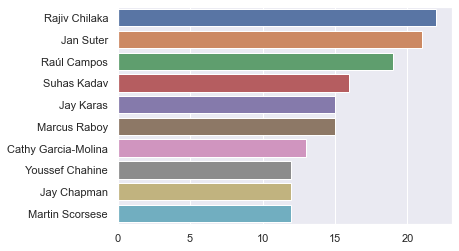

In [ ]:
director1 = director_total[1:11]
sns.barplot(x=director1, y=director1.index)

In [ ]:
onehot_director.info()
# there are nearly 5000 different directors, lets try to lower this number

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 4778 entries,  to Şenol Sönmez
dtypes: bool(4778)
memory usage: 27.9+ MB


In [ ]:
director_percentage = onehot_director.mean().sort_values(ascending=False).round(8) * 100
director_percentage

                         2.796860
Rajiv Chilaka            0.359830
Jan Suter                0.343474
Raúl Campos              0.310762
Suhas Kadav              0.261694
                           ...   
José Miguel Contreras    0.016356
José Ortuño              0.016356
Bob Odenkirk             0.016356
Jovanka Vuckovic         0.016356
Avinash Das              0.016356
Length: 4778, dtype: float64

In [ ]:
director_list = list(director_percentage)
frequency = {}
for item in director_list:
    if item in frequency:
        frequency[item] +=1
    else:
        frequency[item] = 1
print(frequency)

{2.79686: 1, 0.35983: 1, 0.343474: 1, 0.31076200000000004: 1, 0.261694: 1, 0.24533900000000003: 2, 0.212627: 1, 0.196271: 3, 0.179915: 1, 0.16355899999999998: 1, 0.147203: 3, 0.130847: 11, 0.11449100000000001: 17, 0.098135: 28, 0.08178: 40, 0.06542400000000001: 73, 0.049067999999999994: 216, 0.032712000000000005: 568, 0.016356000000000002: 3809}


In [ ]:
#again, some directors have only shot 1 movie, so we'll remove their names from our columns
short_director = director_percentage[director_percentage > 0.017]

list_of_directors = short_director.index
list_of_directors = list(list_of_directors)
onehot_director = onehot_director[list_of_directors]

In [ ]:
onehot_director.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 969 entries,  to A.R. Murugadoss
dtypes: bool(969)
memory usage: 5.7+ MB


In [ ]:
onehot_director.head()

,,Rajiv Chilaka,Jan Suter,Raúl Campos,Suhas Kadav,Jay Karas,Marcus Raboy,Cathy Garcia-Molina,Youssef Chahine,Jay Chapman,Martin Scorsese,Steven Spielberg,Don Michael Paul,Shannon Hartman,David Dhawan,Yılmaz Erdoğan,Robert Rodriguez,Umesh Mehra,Anurag Kashyap,Troy Miller,Johnnie To,Lance Bangs,Kunle Afolayan,Justin G. Dyck,Fernando Ayllón,Hakan Algül,Hanung Bramantyo,Hidenori Inoue,Toshiya Shinohara,Dibakar Banerjee,S.S. Rajamouli,Ryan Polito,Ron Howard,Leslie Small,Ram Gopal Varma,Lasse Hallström,Quentin Tarantino,Prakash Satam,Ozan Açıktan,Omoni Oboli,Noah Baumbach,McG,Mae Czarina Cruz,Clint Eastwood,Ashutosh Gowariker,Anees Bazmee,Rajkumar Santoshi,Steven Soderbergh,Vlad Yudin,Priyadarshan,Manny Rodriguez,Joey So,Jesse V. Johnson,Steve Ball,Wenn V. Deramas,Imtiaz Ali,Matt Askem,David Fincher,Milan Luthria,Tilak Shetty,Steve Brill,William Lau,Riri Riza,Rocky Soraya,Karan Johar,Wong Jing,Kevin Smith,Sameh Abdulaziz,Zoya Akhtar,Sooraj R. Barjatya,Robert Luketic,Robert Vince,Poj Arnon,Stanley Moore,Rajiv Mehra,Nagesh Kukunoor,Ishi Rudell,Anurag Basu,Niyi Akinmolayan,Alex Woo,Shigeaki Kubo,David Batty,Andy Tennant,Antoinette Jadaone,Paul Thomas Anderson,Detlev Buck,Angga Dwimas Sasongko,Spike Lee,Rohit Shetty,Prakash Jha,Thierry Donard,Indra Kumar,Madhur Bhandarkar,Martin Campbell,Kıvanç Baruönü,Mani Ratnam,Wilson Yip,Masahiko Murata,Mahesh Manjrekar,Mastan Alibhai Burmawalla,Ava DuVernay,Abbas Alibhai Burmawalla,Khaled Marei,Lilly Wachowski,Lana Wachowski,Vince Marcello,Vishal Bhardwaj,Jay Roach,Michael Simon,John G. Avildsen,Lynn Shelton,Mike Clattenburg,Robb Wells,Lucas Margutti,Lee Tamahori,Rob Reiner,Rob Minkoff,Roger Kumble,Mike Newell,Frank Capra,Rohit Jugraj,Farah Khan,Jun Lana,Ernie Barbarash,Sean McNamara,Chia-Liang Liu,Savage Steve Holland,Fajar Bustomi,Farhan Akhtar,Abhishek Chaubey,Bo Burnham,Fernando González Molina,Sam Liu,Kundan Shah,Wael Ihsan,Wael Ehsan,Luis Ara,Raja Gosnell,John Paul Tremblay,Yoshiyuki Tomino,Mike Gunther,Clay Glen,Moses Inwang,Michael Tiddes,Bruno Garotti,Nishikant Kamat,Michael McKay,Werner Herzog,Brian Levant,Antonio Campos,Oliver Stone,Antoine Fuqua,Hrishikesh Mukherjee,Paul Dugdale,John Huston,Hernán Zin,Jeremy Saulnier,Peter Farrelly,Peter Segal,Maroun Baghdadi,Philippe Aractingi,Banjong Pisanthanakun,Barry Avrich,Qaushiq Mukherjee,Mike Smith,Rakeysh Omprakash Mehra,Gregory Hoblit,Rathindran R Prasad,Shaun Paul Piccinino,Kayode Kasum,Dennis Dugan,Edward Cotterill,Shyam Benegal,Cristina Jacob,Terry Gilliam,Ahmed Nader Galal,Christopher Storer,Ahmad El-Badri,Steve Carr,Chris Stokes,Conrad Helten,Dan Villegas,Subhash Ghai,David Zucker,Sudhir Mishra,Ivan Reitman,Theodore Boborol,Neeraj Pandey,Burak Aksak,Neal Brennan,Nate Adams,Israel Adrián Caetano,Ismail Farouk,Ömer Faruk Sorak,Munjal Shroff,James Wan,Alex Lehmann,Morgan Neville,Momoko Kamiya,Mohamed Samy,Tate Taylor,Mohamed Hamdy,Jane Campion,Mikhail Red,Ahmed Al-Badry,David Ayer,Mike Flanagan,Ashwin Saravanan,Michèle Ohayon,Yoshikazu Yasuhiko,Asit Mohapatra,Tim Burton,Nila Madhab Panda,TJ Sullivan,Ishaya Bako,Paul W.S. Anderson,Pidi Baiq,Phillip Noyce,Sujoy Ghosh,Sumitra Bhave,Peyton Reed,Petra Costa,Peter Spirer,Akiva Schaffer,Hardik Mehta,Peter Jackson,Sunil Sukthankar,Anirban Majumder,Hasan Karacadağ,Paul Weitz,Chris Weitz,Noriyuki Abe,Paul Greengrass,David R. Ellis,Hiroyuki Seshita,Sylvester Stallone,Pankaj Batra,Pang Ho-cheung,Pablo Larraín,Orlando von Einsiedel,Onir,Olivier Assayas,David Michôd,Adze Ugah,David Mackenzie,Note Chern-Yim,Dante Lam,Jeff Nichols,Atom Egoyan,Jon M. Chu,Latif Faiziyev,Jonathan Demme,Jon Rosenbaum,Leena Yadav,Leigh Janiak,Lekh Tandon,Les Mayfield,Toshiyuki Kubooka,Yasmin Ahmad,Linda Mendoza,Louis C.K.,John Schultz,Bedran Güzel,Adam McKay,Brad Anderson,Craig Brewer,Wolfgang Petersen,Bobcat Goldthwait,Bobby Farrelly,Kim Nguyen,Kief Davidson,Vicky Matthews,Vikas Bahl,Adam Carolla,Blair Simmons,Ketan Mehta,Kenneth Gyang,Ken Ghosh,Vikramaditya Motwane,Karthik Subbaraj,Kazuchika Kise,John Lee Hancock,Maclain Way,

In [ ]:
short_director2 = director_percentage[director_percentage > 0.08]
short_director2
list_of_director2 = short_director2.index
list_of_director2 = list(list_of_director2)
onehot_director2 = onehot_director[list_of_director2]
onehot_director2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 112 entries,  to Mike Clattenburg
dtypes: bool(112)
memory usage: 716.5+ KB


In [ ]:
genres = netflixm.loc[netflixm['listed_in'].notnull(), 'listed_in'].astype('str').apply(lambda t: t.split(', '))
genres = list(genres)

encoder = TransactionEncoder().fit(genres)
onehot_genres = encoder.transform(genres)

onehot_genres = pd.DataFrame(onehot_genres, columns = encoder.columns_, index=netflixm.loc[netflixm.listed_in.notnull(), 'title'])

genres_total = onehot_genres.sum().sort_values(ascending=False)

In [ ]:
genres_total

International Movies        2746
Dramas                      2423
Comedies                    1672
Documentaries                863
Action & Adventure           859
Independent Movies           756
Children & Family Movies     634
Romantic Movies              614
Thrillers                    577
Music & Musicals             373
Horror Movies                357
Stand-Up Comedy              343
Sci-Fi & Fantasy             243
Sports Movies                217
Classic Movies               116
LGBTQ Movies                 102
Cult Movies                   71
Anime Features                70
Faith & Spirituality          65
Movies                        57
dtype: int64

In [ ]:
onehot_genres.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Action & Adventure        6114 non-null   bool 
 1   Anime Features            6114 non-null   bool 
 2   Children & Family Movies  6114 non-null   bool 
 3   Classic Movies            6114 non-null   bool 
 4   Comedies                  6114 non-null   bool 
 5   Cult Movies               6114 non-null   bool 
 6   Documentaries             6114 non-null   bool 
 7   Dramas                    6114 non-null   bool 
 8   Faith & Spirituality      6114 non-null   bool 
 9   Horror Movies             6114 non-null   bool 
 10  Independent Movies        6114 non-null   bool 
 11  International Movies      6114 non-null   bool 
 12  LGBTQ Movies              6114 non-null   bool 
 13  Movies                    6114 non-null   bool 
 14  Music & Musicals        

In [ ]:
onehot_genres = onehot_genres.drop(['Movies'], axis=1)

In [ ]:
onehot_genres.head(10)

,Action & Adventure,Anime Features,Children & Family Movies,Classic Movies,Comedies,Cult Movies,Documentaries,Dramas,Faith & Spirituality,Horror Movies,Independent Movies,International Movies,LGBTQ Movies,Music & Musicals,Romantic Movies,Sci-Fi & Fantasy,Sports Movies,Stand-Up Comedy,Thrillers
title,,,,,,,,,,,,,,,,,,,
Dick Johnson Is Dead,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False
My Little Pony: A New Generation,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Sankofa,False,False,False,False,False,False,False,True,False,False,True,True,False,False,False,False,False,False,False
The Starling,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False
Je Suis Karl,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False
Confessions of an Invisible Girl,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
Europe's Most Dangerous Man: Otto Skorzeny in Spain,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False
Intrusion,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
Avvai Shanmughi,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False


In [ ]:
genres_total = onehot_genres.sum().sort_values(ascending=False)

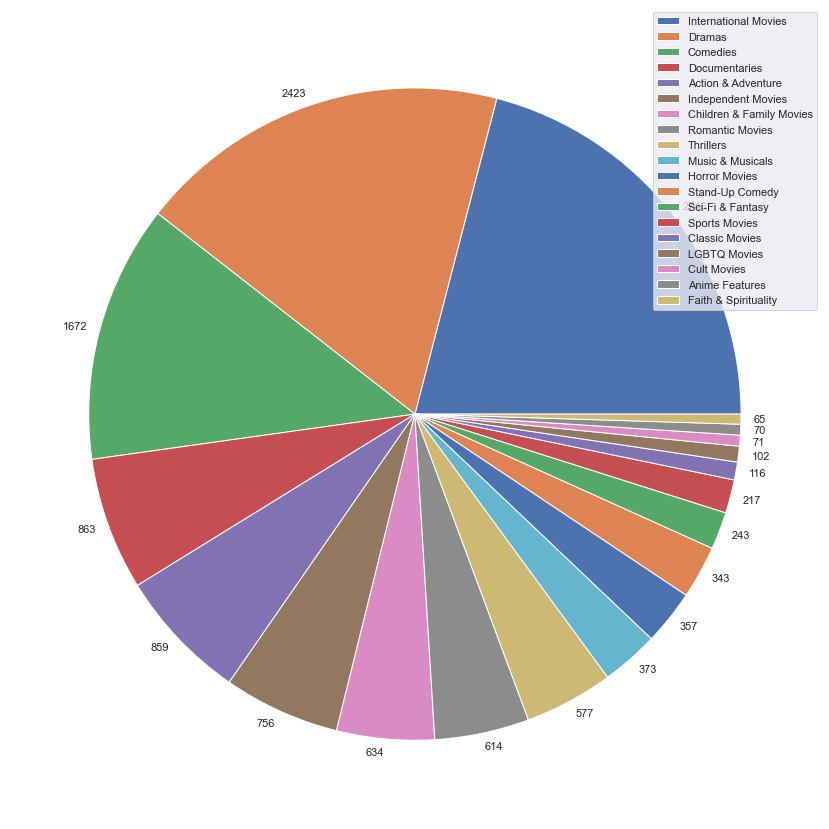

In [ ]:
fig1, ax1 = plt.subplots(figsize=(20,15), facecolor='white')
ax1.pie(genres_total, labels = genres_total, labeldistance=1.04)
plt.legend(labels = genres_total.index)
plt.show()

In [ ]:
netflixm.loc[netflixm['description'].notnull(), 'description']

0       As her father nears the end of his life, filmm...
6       Equestria's divided. But a bright-eyed hero be...
7       On a photo shoot in Ghana, an American model s...
9       A woman adjusting to life after a loss contend...
12      After most of her family is murdered in a terr...
                              ...                        
8801    Recovering alcoholic Talal wakes up inside a s...
8802    A political cartoonist, a crime reporter and a...
8804    Looking to survive in a world taken over by zo...
8805    Dragged from civilian life, a former superhero...
8806    A scrappy but poor boy worms his way into a ty...
Name: description, Length: 6114, dtype: object

In [ ]:
netflixm["description_clean"] = netflixm['description'].str.replace('[^\w\s]','')

In [ ]:
netflixm["description_clean"] = netflixm["description_clean"].fillna("").str.lower()

In [ ]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /Users/yeti/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
stop_words = stopwords.words('english')
netflixm["description_clean"] = netflixm["description_clean"].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

In [ ]:
#lets try one-hotting the description as well
description = netflixm.loc[netflixm['description_clean'].notnull(), 'description_clean'].astype('str').apply(lambda t: t.split(' '))
description = list(description)

encoder = TransactionEncoder().fit(description)
onehot_description = encoder.transform(description)

onehot_description = pd.DataFrame(onehot_description, columns = encoder.columns_, index=netflixm.loc[netflixm.description.notnull(), 'title'])

description_total = onehot_description.sum().sort_values(ascending=False)

In [ ]:
description_total

young          554
life           517
new            457
man            403
family         391
              ... 
ed               1
opinionated      1
opinion          1
ophelias         1
şeref            1
Length: 16927, dtype: int64

In [ ]:
description_percentage = onehot_description.mean().sort_values(ascending=False).round(8) * 100
description_percentage

young          9.061171
life           8.456003
new            7.474648
man            6.591430
family         6.395159
                 ...   
ed             0.016356
opinionated    0.016356
opinion        0.016356
ophelias       0.016356
şeref          0.016356
Length: 16927, dtype: float64

In [ ]:
description_list = list(description_percentage)

In [ ]:
frequency = {}
for item in description_list:
    if item in frequency:
        frequency[item] +=1
    else:
        frequency[item] = 1
print(frequency)

{9.061171: 1, 8.456002999999999: 1, 7.474648: 1, 6.59143: 1, 6.3951590000000005: 1, 5.839058: 1, 5.675498999999999: 1, 5.299313: 1, 5.053974: 1, 4.923127: 1, 4.497874: 1, 4.170756: 1, 4.07262: 1, 3.827282: 1, 3.7455019999999997: 2, 3.4838080000000002: 1, 3.271181: 1, 3.173045: 2, 2.993131: 1, 2.8949949999999998: 1, 2.8459269999999997: 1, 2.829571: 1, 2.780504: 1, 2.764148: 1, 2.682368: 1, 2.666012: 1, 2.649657: 1, 2.616945: 1, 2.486097: 1, 2.453386: 1, 2.404318: 1, 2.3388940000000003: 1, 2.257115: 1, 2.224403: 1, 2.175335: 3, 2.158979: 1, 2.142623: 5, 2.126268: 2, 2.109912: 1, 2.093556: 1, 2.060844: 2, 1.946353: 2, 1.929997: 1, 1.8972849999999999: 1, 1.864573: 3, 1.848217: 1, 1.815505: 1, 1.7991489999999999: 4, 1.782794: 2, 1.766438: 2, 1.733726: 1, 1.71737: 1, 1.684658: 1, 1.6355899999999999: 3, 1.6028790000000002: 5, 1.5865230000000001: 2, 1.570167: 2, 1.553811: 2, 1.537455: 1, 1.521099: 1, 1.504743: 1, 1.4883870000000001: 2, 1.472031: 2, 1.455675: 1, 1.43932: 2, 1.422964: 1, 1.40660

In [ ]:
# we're only going to keep description words that appear at least 3 times
short_description = description_percentage[description_percentage > 0.04]
short_description


young        9.061171
life         8.456003
new          7.474648
man          6.591430
family       6.395159
               ...   
puppets      0.049068
hardships    0.049068
inherited    0.049068
premier      0.049068
clawdeen     0.049068
Length: 5791, dtype: float64

In [ ]:
description2 = short_description[:20]
description2

young          9.061171
life           8.456003
new            7.474648
man            6.591430
family         6.395159
woman          5.839058
two            5.675499
love           5.299313
documentary    5.053974
must           4.923127
friends        4.497874
world          4.170756
find           4.072620
finds          3.827282
home           3.745502
one            3.745502
takes          3.483808
three          3.271181
father         3.173045
help           3.173045
dtype: float64

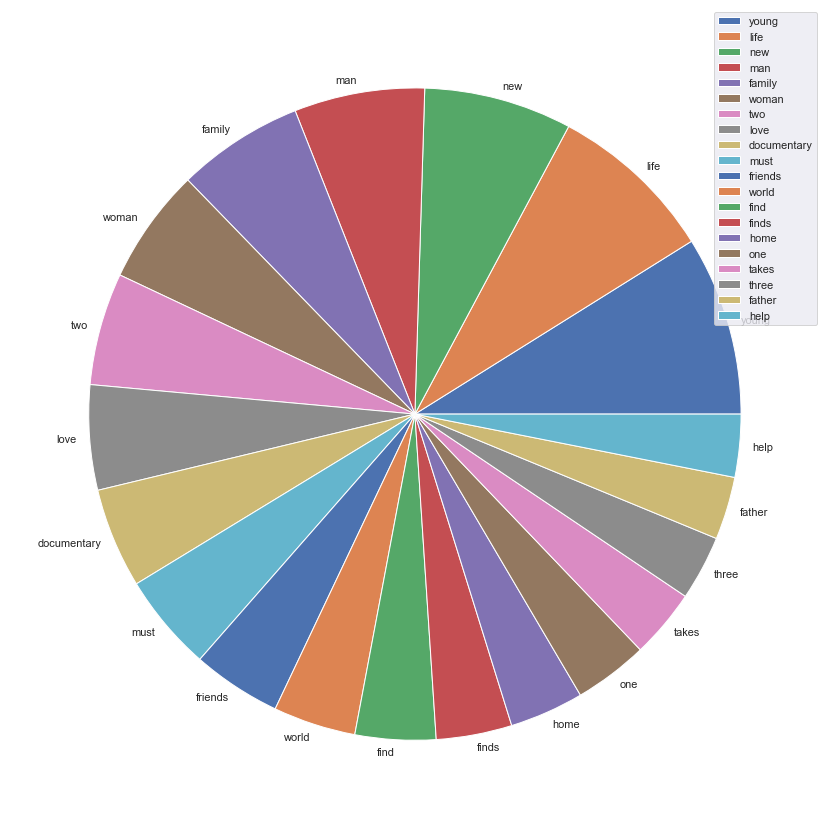

In [ ]:
fig1, ax1 = plt.subplots(figsize=(20,15), facecolor='white')
ax1.pie(description2, labels = description2.index, labeldistance=1.04)
plt.legend(labels = description2.index)
plt.show()

In [ ]:
list_of_description = short_description.index
list_of_description = list(list_of_description)
onehot_description = onehot_description[list_of_description]

In [ ]:
onehot_description.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 5791 entries, young to clawdeen
dtypes: bool(5791)
memory usage: 33.8+ MB


In [ ]:
onehot_description.head()

young   life    new    man  family  woman  \
title                                                                         
Dick Johnson Is Dead              False   True  False  False   False  False   
My Little Pony: A New Generation  False  False  False  False   False  False   
Sankofa                           False  False  False  False   False  False   
The Starling                      False   True  False  False   False   True   
Je Suis Karl                       True  False  False  False    True   True   

                                    two   love  documentary   must  friends  \
title                                                                         
Dick Johnson Is Dead              False  False        False  False    False   
My Little Pony: A New Generation  False  False        False  False    False   
Sankofa                           False  False        False  False    False   
The Starling                      False  False        False  False    False   
Je Suis Karl                      False  False        False  False    False   

                                  world   find  finds   home    one  takes  \
title                                                                        
Dick Johnson Is Dead              False  False  False  False  False  False   
My Little Pony: A New Generation  False  False  False  False  False  False   
Sankofa                           False  False  False  False  False  False   
The Starling                      False   True  False  False  False  False   
Je Suis Karl                      False  False  False  False  False  False   

                                  three  father   help  school  years  lives  \
title                                                                          
Dick Johnson Is Dead              False    True   True   False  False  False   
My Little Pony: A New Generation  False   False  False   False  False  False   
Sankofa                           False   False  False   False  False  False   
The Starling                      False   False  False   False  False  False   
Je Suis Karl                      False   False  False   False  False  False   

                                   take   save   girl  special  group   back  \
title                                                                          
Dick Johnson Is Dead              False  False  False    False  False  False   
My Little Pony: A New Generation  False  False  False    False  False  False   
Sankofa                           False  False  False    False  False   True   
The Starling                      False  False  False    False  False  False   
Je Suis Karl                      False  False  False    False   True  False   

                                  daughter    son   teen  becomes    get  \
title                                                                      
Dick Johnson Is Dead                 False  False  False    False  False   
My Little Pony: A New Generation     False  False  False    False  False   
Sankofa                              False  False  False     True  False   
The Starling                         False  False  False    False  False   
Je Suis Karl                         False  False  False    False  False   

                                   gets    hes    war  mother  standup  \
title                                                                    
Dick Johnson Is Dead              False  False  False   False    False   
My Little Pony: A New Generation  False  False  False   False    False   
Sankofa                           False  False  False   False    False   
The Starling                      False  False  False   False    False   
Je Suis Karl                      False  False  False   False    False   

                                  friend   past  falls  story   wife   soon  \
title                                                                         
Dick Johnson Is Dead               False  False

In [ ]:
onehot_description2=onehot_description.drop(columns=['title'])
onehot_description2.head()

young   life    new    man  family  woman  \
title                                                                         
Dick Johnson Is Dead              False   True  False  False   False  False   
My Little Pony: A New Generation  False  False  False  False   False  False   
Sankofa                           False  False  False  False   False  False   
The Starling                      False   True  False  False   False   True   
Je Suis Karl                       True  False  False  False    True   True   

                                    two   love  documentary   must  friends  \
title                                                                         
Dick Johnson Is Dead              False  False        False  False    False   
My Little Pony: A New Generation  False  False        False  False    False   
Sankofa                           False  False        False  False    False   
The Starling                      False  False        False  False    False   
Je Suis Karl                      False  False        False  False    False   

                                  world   find  finds   home    one  takes  \
title                                                                        
Dick Johnson Is Dead              False  False  False  False  False  False   
My Little Pony: A New Generation  False  False  False  False  False  False   
Sankofa                           False  False  False  False  False  False   
The Starling                      False   True  False  False  False  False   
Je Suis Karl                      False  False  False  False  False  False   

                                  three  father   help  school  years  lives  \
title                                                                          
Dick Johnson Is Dead              False    True   True   False  False  False   
My Little Pony: A New Generation  False   False  False   False  False  False   
Sankofa                           False   False  False   False  False  False   
The Starling                      False   False  False   False  False  False   
Je Suis Karl                      False   False  False   False  False  False   

                                   take   save   girl  special  group   back  \
title                                                                          
Dick Johnson Is Dead              False  False  False    False  False  False   
My Little Pony: A New Generation  False  False  False    False  False  False   
Sankofa                           False  False  False    False  False   True   
The Starling                      False  False  False    False  False  False   
Je Suis Karl                      False  False  False    False   True  False   

                                  daughter    son   teen  becomes    get  \
title                                                                      
Dick Johnson Is Dead                 False  False  False    False  False   
My Little Pony: A New Generation     False  False  False    False  False   
Sankofa                              False  False  False     True  False   
The Starling                         False  False  False    False  False   
Je Suis Karl                         False  False  False    False  False   

                                   gets    hes    war  mother  standup  \
title                                                                    
Dick Johnson Is Dead              False  False  False   False    False   
My Little Pony: A New Generation  False  False  False   False    False   
Sankofa                           False  False  False   False    False   
The Starling                      False  False  False   False    False   
Je Suis Karl                      False  False  False   False    False   

                                  friend   past  falls  story   wife   soon  \
title                                                                         
Dick Johnson Is Dead               False  False

In [ ]:
# #lets try one-hotting the description as well
# description = netflixm.loc[netflixm['description_clean'].notnull(), 'description_clean'].astype('str').apply(lambda t: t.split(' '))
# description = list(description)

# encoder = TransactionEncoder().fit(description)
# onehot_description22 = encoder.transform(description)

# onehot_description22 = pd.DataFrame(onehot_description22, columns = encoder.columns_, index=netflixm.loc[netflixm.description.notnull(), 'title'])

# description_total = onehot_description22.sum().sort_values(ascending=False)

In [ ]:
short_description2 = description_percentage[description_percentage > 0.17]
list_of_description2 = short_description2.index
list_of_description2 = list(list_of_description2)
onehot_description22 = onehot_description2[list_of_description2]
onehot_description22.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6114 entries, Dick Johnson Is Dead to Zubaan
Columns: 1638 entries, young to general
dtypes: bool(1638)
memory usage: 9.6+ MB


In [ ]:
# onehot_description22.head()

In [ ]:
netflixm['title']

0                   Dick Johnson Is Dead
6       My Little Pony: A New Generation
7                                Sankofa
9                           The Starling
12                          Je Suis Karl
                      ...               
8801                             Zinzana
8802                              Zodiac
8804                          Zombieland
8805                                Zoom
8806                              Zubaan
Name: title, Length: 6114, dtype: object

In [ ]:
netflixm2 = netflixm.copy()

In [ ]:
# now lets merge all the onehot tables into our main dataframe

netflix_merge = netflixm.merge(onehot_director, on='title')
netflix_merge = netflix_merge.merge(onehot_genres, on='title')
netflix_merge = netflix_merge.merge(onehot_cast, on='title')
netflix_merge = netflix_merge.merge(onehot_country, on='title')
netflix_merge = netflix_merge.merge(onehot_description2, on='title')

In [ ]:
netflixm2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 8806
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   title              6114 non-null   object
 1   director           6114 non-null   object
 2   cast               6114 non-null   object
 3   country            6114 non-null   object
 4   release_year       6114 non-null   int64 
 5   rating             6114 non-null   object
 6   listed_in          6114 non-null   object
 7   description        6114 non-null   object
 8   description_clean  6114 non-null   object
dtypes: int64(1), object(8)
memory usage: 477.7+ KB


In [ ]:
netflix_merge2 = netflixm2.merge(onehot_director2, on='title')
netflix_merge2 = netflix_merge2.merge(onehot_genres, on='title')
netflix_merge2 = netflix_merge2.merge(onehot_cast2, on='title')
netflix_merge2 = netflix_merge2.merge(onehot_description22, on='title')

In [ ]:
netflix_merge.head()

,title,director_x,cast_x,country_x,release_year,rating,listed_in,description,description_clean,_x,Rajiv Chilaka,Jan Suter,Raúl Campos,Suhas Kadav,Jay Karas,Marcus Raboy,Cathy Garcia-Molina,Youssef Chahine_x,Jay Chapman,Martin Scorsese,Steven Spielberg,Don Michael Paul,Shannon Hartman,David Dhawan,Yılmaz Erdoğan_x,Robert Rodriguez,Umesh Mehra,Anurag Kashyap,Troy Miller,Johnnie To,Lance Bangs,Kunle Afolayan_x,Justin G. Dyck,Fernando Ayllón,Hakan Algül,Hanung Bramantyo,Hidenori Inoue,Toshiya Shinohara,Dibakar Banerjee,S.S. Rajamouli,Ryan Polito,Ron Howard,Leslie Small,Ram Gopal Varma,Lasse Hallström,Quentin Tarantino,Prakash Satam,Ozan Açıktan,Omoni Oboli_x,Noah Baumbach,McG,Mae Czarina Cruz,Clint Eastwood_x,Ashutosh Gowariker,Anees Bazmee,Rajkumar Santoshi,Steven Soderbergh,Vlad Yudin,Priyadarshan,Manny Rodriguez,Joey So,Jesse V. Johnson,Steve Ball,Wenn V. Deramas,Imtiaz Ali,Matt Askem,David Fincher,Milan Luthria,Tilak Shetty,Steve Brill,William Lau,Riri Riza,Rocky Soraya,Karan Johar,Wong Jing_x,Kevin Smith_x,Sameh Abdulaziz,Zoya Akhtar,Sooraj R. Barjatya,Robert Luketic,Robert Vince,Poj Arnon,Stanley Moore_x,Rajiv Mehra,Nagesh Kukunoor_x,Ishi Rudell,Anurag Basu,Niyi Akinmolayan,Alex Woo,Shigeaki Kubo,David Batty,Andy Tennant,Antoinette Jadaone,Paul Thomas Anderson,Detlev Buck,Angga Dwimas Sasongko,Spike Lee,Rohit Shetty,Prakash Jha,Thierry Donard,Indra Kumar,Madhur Bhandarkar,Martin Campbell,Kıvanç Baruönü,Mani Ratnam,Wilson Yip,Masahiko Murata,Mahesh Manjrekar_x,Mastan Alibhai Burmawalla,Ava DuVernay_x,Abbas Alibhai Burmawalla,Khaled Marei,Lilly Wachowski,Lana Wachowski,Vince Marcello,Vishal Bhardwaj,Jay Roach,Michael Simon,John G. Avildsen,Lynn Shelton,Mike Clattenburg,Robb Wells_x,Lucas Margutti,Lee Tamahori,Rob Reiner_x,Rob Minkoff,Roger Kumble,Mike Newell,Frank Capra,Rohit Jugraj,Farah Khan,Jun Lana,Ernie Barbarash,Sean McNamara,Chia-Liang Liu_x,Savage Steve Holland,Fajar Bustomi,Farhan Akhtar_x,Abhishek Chaubey,Bo Burnham_x,Fernando González Molina,Sam Liu,Kundan Shah,Wael Ihsan,Wael Ehsan,Luis Ara,Raja Gosnell,John Paul Tremblay_x,Yoshiyuki Tomino,Mike Gunther,Clay Glen,Moses Inwang,Michael Tiddes,Bruno Garotti,Nishikant Kamat_x,Michael McKay,Werner Herzog_x,Brian Levant,Antonio Campos,Oliver Stone,Antoine Fuqua,Hrishikesh Mukherjee,Paul Dugdale,John Huston,Hernán Zin,Jeremy Saulnier,Peter Farrelly,Peter Segal,Maroun Baghdadi,Philippe Aractingi,Banjong Pisanthanakun,Barry Avrich,Qaushiq Mukherjee,Mike Smith_x,Rakeysh Omprakash Mehra,Gregory Hoblit,Rathindran R Prasad,Shaun Paul Piccinino,Kayode Kasum,Dennis Dugan,Edward Cotterill,Shyam Benegal,Cristina Jacob,Terry Gilliam_x,Ahmed Nader Galal,Christopher Storer,Ahmad El-Badri,Steve Carr,Chris Stokes,Conrad Helten,Dan Villegas,Subhash Ghai_x,David Zucker,Sudhir Mishra,Ivan Reitman,Theodore Boborol,Neeraj Pandey,Burak Aksak,Neal Brennan,Nate Adams,Israel Adrián Caetano,Ismail Farouk,Ömer Faruk Sorak,Munjal Shroff,James Wan,Alex Lehmann,Morgan Neville,Momoko Kamiya,Mohamed Samy,Tate Taylor,Mohamed Hamdy,Jane Campion,Mikhail Red,Ahmed Al-Badry,David Ayer,Mike Flanagan,Ashwin Saravanan,Michèle Ohayon,Yoshikazu Yasuhiko,Asit Mohapatra,Tim Burton,Nila Madhab Panda,TJ Sullivan,Ishaya Bako,Paul W.S. Anderson,Pidi Baiq,Phillip Noyce,Sujoy Ghosh,Sumitra Bhave,Peyton Reed,Petra Costa,Peter Spirer,Akiva Schaffer_x,Hardik Mehta,Peter Jackson,Sunil Sukthankar,Anirban Majumder,Hasan Karacadağ,Paul Weitz_x,Chris Weitz,Noriyuki Abe,Paul Greengrass,David R. Ellis,Hiroyuki Seshita,Sylvester Stallone_x,Pankaj Batra,Pang Ho-cheung,Pablo Larraín,Orlando von Einsiedel,Onir,Olivier Assayas,David Michôd,Adze Ugah,David Mackenzie,Note Chern-Yim_x,Dante Lam,Jeff Nichols,Atom Egoyan,Jon M. Chu,Latif Faiziyev,Jonathan Demme,Jon Rosenbaum,Leena Yadav,Leigh Janiak,Lekh Tandon_x,Les Mayfield,Toshiyuki Kubooka,Yasmin Ahmad,Linda Mendoza,Louis C.K._x,John Schultz,Bedran Güzel,Adam McKay,Brad Anderson,Craig Brewer,Wolfgang Petersen,Bobcat Goldthwait,Bobby Farrelly,Kim Nguyen,Kief Davidson,Vicky Matthews,Vika

In [ ]:
netflix_merge2.head()

title                     director_x  \
0              Dick Johnson Is Dead                Kirsten Johnson   
1  My Little Pony: A New Generation  Robert Cullen, José Luis Ucha   
2                           Sankofa                   Haile Gerima   
3                      The Starling                 Theodore Melfi   
4                      Je Suis Karl            Christian Schwochow   

                                              cast_x  \
0                                                      
1  Vanessa Hudgens, Kimiko Glenn, James Marsden, ...   
2  Kofi Ghanaba, Oyafunmike Ogunlano, Alexandra D...   
3  Melissa McCarthy, Chris O'Dowd, Kevin Kline, T...   
4  Luna Wedler, Jannis Niewöhner, Milan Peschel, ...   

                                           country_x  release_year rating  \
0                                      United States          2020  PG-13   
1                                                             2021     PG   
2  United States, Ghana, Burkina Faso, United Kin...          1993  TV-MA   
3                                      United States          2021  PG-13   
4                            Germany, Czech Republic          2021  TV-MA   

                                          listed_in  \
0                                     Documentaries   
1                          Children & Family Movies   
2  Dramas, Independent Movies, International Movies   
3                                  Comedies, Dramas   
4                      Dramas, International Movies   

                                         description  \
0  As her father nears the end of his life, filmm...   
1  Equestria's divided. But a bright-eyed hero be...   
2  On a photo shoot in Ghana, an American model s...   
3  A woman adjusting to life after a loss contend...   
4  After most of her family is murdered in a terr...   

                                   description_clean     _x  Rajiv Chilaka  \
0  father nears end life filmmaker kirsten johnso...  False          False   
1  equestrias divided brighteyed hero believes ea...  False          False   
2  photo shoot ghana american model slips back ti...  False          False   
3  woman adjusting life loss contends feisty bird...  False          False   
4  family murdered terrorist bombing young woman ...  False          False   

   Jan Suter  Raúl Campos  Suhas Kadav  Jay Karas  Marcus Raboy  \
0      False        False        False      False         False   
1      False        False        False      False         False   
2      False        False        False      False         False   
3      False        False        False      False         False   
4      False        False        False      False         False   

   Cathy Garcia-Molina  Youssef Chahine  Jay Chapman  Martin Scorsese  \
0                False            False        False            False   
1                False            False        False            False   
2                False            False        False            False   
3                False            False        False            False   
4                False            False        False            False   

   Steven Spielberg  Don Michael Paul  Shannon Hartman  David Dhawan  \
0             False             False            False         False   
1             False             False            False         False   
2             False             False            False         False   
3             False             False            False         False   
4             False             False            False         False   

   Yılmaz Erdoğan  Robert Rodriguez  Umesh Mehra  Anurag Kashyap  Troy Miller  \
0           False             False        False           False        False   
1           False             False        False           False        False   
2           False             False        False           False        False   
3           False             False        False           False        F

In [ ]:
netflixd = netflix_merge.drop(columns = ['director_x', 'cast_x', 'country_x', 'listed_in', 'description', 'description_clean', '_x', ''])

In [ ]:
netflixd.head()

,title,release_year,rating,Rajiv Chilaka,Jan Suter,Raúl Campos,Suhas Kadav,Jay Karas,Marcus Raboy,Cathy Garcia-Molina,Youssef Chahine_x,Jay Chapman,Martin Scorsese,Steven Spielberg,Don Michael Paul,Shannon Hartman,David Dhawan,Yılmaz Erdoğan_x,Robert Rodriguez,Umesh Mehra,Anurag Kashyap,Troy Miller,Johnnie To,Lance Bangs,Kunle Afolayan_x,Justin G. Dyck,Fernando Ayllón,Hakan Algül,Hanung Bramantyo,Hidenori Inoue,Toshiya Shinohara,Dibakar Banerjee,S.S. Rajamouli,Ryan Polito,Ron Howard,Leslie Small,Ram Gopal Varma,Lasse Hallström,Quentin Tarantino,Prakash Satam,Ozan Açıktan,Omoni Oboli_x,Noah Baumbach,McG,Mae Czarina Cruz,Clint Eastwood_x,Ashutosh Gowariker,Anees Bazmee,Rajkumar Santoshi,Steven Soderbergh,Vlad Yudin,Priyadarshan,Manny Rodriguez,Joey So,Jesse V. Johnson,Steve Ball,Wenn V. Deramas,Imtiaz Ali,Matt Askem,David Fincher,Milan Luthria,Tilak Shetty,Steve Brill,William Lau,Riri Riza,Rocky Soraya,Karan Johar,Wong Jing_x,Kevin Smith_x,Sameh Abdulaziz,Zoya Akhtar,Sooraj R. Barjatya,Robert Luketic,Robert Vince,Poj Arnon,Stanley Moore_x,Rajiv Mehra,Nagesh Kukunoor_x,Ishi Rudell,Anurag Basu,Niyi Akinmolayan,Alex Woo,Shigeaki Kubo,David Batty,Andy Tennant,Antoinette Jadaone,Paul Thomas Anderson,Detlev Buck,Angga Dwimas Sasongko,Spike Lee,Rohit Shetty,Prakash Jha,Thierry Donard,Indra Kumar,Madhur Bhandarkar,Martin Campbell,Kıvanç Baruönü,Mani Ratnam,Wilson Yip,Masahiko Murata,Mahesh Manjrekar_x,Mastan Alibhai Burmawalla,Ava DuVernay_x,Abbas Alibhai Burmawalla,Khaled Marei,Lilly Wachowski,Lana Wachowski,Vince Marcello,Vishal Bhardwaj,Jay Roach,Michael Simon,John G. Avildsen,Lynn Shelton,Mike Clattenburg,Robb Wells_x,Lucas Margutti,Lee Tamahori,Rob Reiner_x,Rob Minkoff,Roger Kumble,Mike Newell,Frank Capra,Rohit Jugraj,Farah Khan,Jun Lana,Ernie Barbarash,Sean McNamara,Chia-Liang Liu_x,Savage Steve Holland,Fajar Bustomi,Farhan Akhtar_x,Abhishek Chaubey,Bo Burnham_x,Fernando González Molina,Sam Liu,Kundan Shah,Wael Ihsan,Wael Ehsan,Luis Ara,Raja Gosnell,John Paul Tremblay_x,Yoshiyuki Tomino,Mike Gunther,Clay Glen,Moses Inwang,Michael Tiddes,Bruno Garotti,Nishikant Kamat_x,Michael McKay,Werner Herzog_x,Brian Levant,Antonio Campos,Oliver Stone,Antoine Fuqua,Hrishikesh Mukherjee,Paul Dugdale,John Huston,Hernán Zin,Jeremy Saulnier,Peter Farrelly,Peter Segal,Maroun Baghdadi,Philippe Aractingi,Banjong Pisanthanakun,Barry Avrich,Qaushiq Mukherjee,Mike Smith_x,Rakeysh Omprakash Mehra,Gregory Hoblit,Rathindran R Prasad,Shaun Paul Piccinino,Kayode Kasum,Dennis Dugan,Edward Cotterill,Shyam Benegal,Cristina Jacob,Terry Gilliam_x,Ahmed Nader Galal,Christopher Storer,Ahmad El-Badri,Steve Carr,Chris Stokes,Conrad Helten,Dan Villegas,Subhash Ghai_x,David Zucker,Sudhir Mishra,Ivan Reitman,Theodore Boborol,Neeraj Pandey,Burak Aksak,Neal Brennan,Nate Adams,Israel Adrián Caetano,Ismail Farouk,Ömer Faruk Sorak,Munjal Shroff,James Wan,Alex Lehmann,Morgan Neville,Momoko Kamiya,Mohamed Samy,Tate Taylor,Mohamed Hamdy,Jane Campion,Mikhail Red,Ahmed Al-Badry,David Ayer,Mike Flanagan,Ashwin Saravanan,Michèle Ohayon,Yoshikazu Yasuhiko,Asit Mohapatra,Tim Burton,Nila Madhab Panda,TJ Sullivan,Ishaya Bako,Paul W.S. Anderson,Pidi Baiq,Phillip Noyce,Sujoy Ghosh,Sumitra Bhave,Peyton Reed,Petra Costa,Peter Spirer,Akiva Schaffer_x,Hardik Mehta,Peter Jackson,Sunil Sukthankar,Anirban Majumder,Hasan Karacadağ,Paul Weitz_x,Chris Weitz,Noriyuki Abe,Paul Greengrass,David R. Ellis,Hiroyuki Seshita,Sylvester Stallone_x,Pankaj Batra,Pang Ho-cheung,Pablo Larraín,Orlando von Einsiedel,Onir,Olivier Assayas,David Michôd,Adze Ugah,David Mackenzie,Note Chern-Yim_x,Dante Lam,Jeff Nichols,Atom Egoyan,Jon M. Chu,Latif Faiziyev,Jonathan Demme,Jon Rosenbaum,Leena Yadav,Leigh Janiak,Lekh Tandon_x,Les Mayfield,Toshiyuki Kubooka,Yasmin Ahmad,Linda Mendoza,Louis C.K._x,John Schultz,Bedran Güzel,Adam McKay,Brad Anderson,Craig Brewer,Wolfgang Petersen,Bobcat Goldthwait,Bobby Farrelly,Kim Nguyen,Kief Davidson,Vicky Matthews,Vikas Bahl,Adam Carolla,Blair Simmons,Ketan Mehta,Kenneth Gyang,Ken Ghosh,V

In [ ]:
netflixd.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 6113
Columns: 14182 entries, title to clawdeen
dtypes: bool(14179), int64(1), object(2)
memory usage: 82.9+ MB


In [ ]:
#lets categorize rating, turn our trues into 1 and falses onto 0
netflixd['rating'] = pd.Categorical(netflixd['rating'])
netflixd['maturity_rating'] = netflixd['rating'].cat.codes
netflixd = netflixd.drop(columns = ['rating'])

In [ ]:
netflixd['maturity_rating']

0       3
1       2
2       5
3       3
4       5
       ..
6109    5
6110    4
6111    4
6112    2
6113    3
Name: maturity_rating, Length: 6114, dtype: int8

In [ ]:
netflixd2 = netflixd * 1

In [ ]:
netflix_hot = netflixd2.copy()
netflix_hot.head()

,title,release_year,Rajiv Chilaka,Jan Suter,Raúl Campos,Suhas Kadav,Jay Karas,Marcus Raboy,Cathy Garcia-Molina,Youssef Chahine_x,Jay Chapman,Martin Scorsese,Steven Spielberg,Don Michael Paul,Shannon Hartman,David Dhawan,Yılmaz Erdoğan_x,Robert Rodriguez,Umesh Mehra,Anurag Kashyap,Troy Miller,Johnnie To,Lance Bangs,Kunle Afolayan_x,Justin G. Dyck,Fernando Ayllón,Hakan Algül,Hanung Bramantyo,Hidenori Inoue,Toshiya Shinohara,Dibakar Banerjee,S.S. Rajamouli,Ryan Polito,Ron Howard,Leslie Small,Ram Gopal Varma,Lasse Hallström,Quentin Tarantino,Prakash Satam,Ozan Açıktan,Omoni Oboli_x,Noah Baumbach,McG,Mae Czarina Cruz,Clint Eastwood_x,Ashutosh Gowariker,Anees Bazmee,Rajkumar Santoshi,Steven Soderbergh,Vlad Yudin,Priyadarshan,Manny Rodriguez,Joey So,Jesse V. Johnson,Steve Ball,Wenn V. Deramas,Imtiaz Ali,Matt Askem,David Fincher,Milan Luthria,Tilak Shetty,Steve Brill,William Lau,Riri Riza,Rocky Soraya,Karan Johar,Wong Jing_x,Kevin Smith_x,Sameh Abdulaziz,Zoya Akhtar,Sooraj R. Barjatya,Robert Luketic,Robert Vince,Poj Arnon,Stanley Moore_x,Rajiv Mehra,Nagesh Kukunoor_x,Ishi Rudell,Anurag Basu,Niyi Akinmolayan,Alex Woo,Shigeaki Kubo,David Batty,Andy Tennant,Antoinette Jadaone,Paul Thomas Anderson,Detlev Buck,Angga Dwimas Sasongko,Spike Lee,Rohit Shetty,Prakash Jha,Thierry Donard,Indra Kumar,Madhur Bhandarkar,Martin Campbell,Kıvanç Baruönü,Mani Ratnam,Wilson Yip,Masahiko Murata,Mahesh Manjrekar_x,Mastan Alibhai Burmawalla,Ava DuVernay_x,Abbas Alibhai Burmawalla,Khaled Marei,Lilly Wachowski,Lana Wachowski,Vince Marcello,Vishal Bhardwaj,Jay Roach,Michael Simon,John G. Avildsen,Lynn Shelton,Mike Clattenburg,Robb Wells_x,Lucas Margutti,Lee Tamahori,Rob Reiner_x,Rob Minkoff,Roger Kumble,Mike Newell,Frank Capra,Rohit Jugraj,Farah Khan,Jun Lana,Ernie Barbarash,Sean McNamara,Chia-Liang Liu_x,Savage Steve Holland,Fajar Bustomi,Farhan Akhtar_x,Abhishek Chaubey,Bo Burnham_x,Fernando González Molina,Sam Liu,Kundan Shah,Wael Ihsan,Wael Ehsan,Luis Ara,Raja Gosnell,John Paul Tremblay_x,Yoshiyuki Tomino,Mike Gunther,Clay Glen,Moses Inwang,Michael Tiddes,Bruno Garotti,Nishikant Kamat_x,Michael McKay,Werner Herzog_x,Brian Levant,Antonio Campos,Oliver Stone,Antoine Fuqua,Hrishikesh Mukherjee,Paul Dugdale,John Huston,Hernán Zin,Jeremy Saulnier,Peter Farrelly,Peter Segal,Maroun Baghdadi,Philippe Aractingi,Banjong Pisanthanakun,Barry Avrich,Qaushiq Mukherjee,Mike Smith_x,Rakeysh Omprakash Mehra,Gregory Hoblit,Rathindran R Prasad,Shaun Paul Piccinino,Kayode Kasum,Dennis Dugan,Edward Cotterill,Shyam Benegal,Cristina Jacob,Terry Gilliam_x,Ahmed Nader Galal,Christopher Storer,Ahmad El-Badri,Steve Carr,Chris Stokes,Conrad Helten,Dan Villegas,Subhash Ghai_x,David Zucker,Sudhir Mishra,Ivan Reitman,Theodore Boborol,Neeraj Pandey,Burak Aksak,Neal Brennan,Nate Adams,Israel Adrián Caetano,Ismail Farouk,Ömer Faruk Sorak,Munjal Shroff,James Wan,Alex Lehmann,Morgan Neville,Momoko Kamiya,Mohamed Samy,Tate Taylor,Mohamed Hamdy,Jane Campion,Mikhail Red,Ahmed Al-Badry,David Ayer,Mike Flanagan,Ashwin Saravanan,Michèle Ohayon,Yoshikazu Yasuhiko,Asit Mohapatra,Tim Burton,Nila Madhab Panda,TJ Sullivan,Ishaya Bako,Paul W.S. Anderson,Pidi Baiq,Phillip Noyce,Sujoy Ghosh,Sumitra Bhave,Peyton Reed,Petra Costa,Peter Spirer,Akiva Schaffer_x,Hardik Mehta,Peter Jackson,Sunil Sukthankar,Anirban Majumder,Hasan Karacadağ,Paul Weitz_x,Chris Weitz,Noriyuki Abe,Paul Greengrass,David R. Ellis,Hiroyuki Seshita,Sylvester Stallone_x,Pankaj Batra,Pang Ho-cheung,Pablo Larraín,Orlando von Einsiedel,Onir,Olivier Assayas,David Michôd,Adze Ugah,David Mackenzie,Note Chern-Yim_x,Dante Lam,Jeff Nichols,Atom Egoyan,Jon M. Chu,Latif Faiziyev,Jonathan Demme,Jon Rosenbaum,Leena Yadav,Leigh Janiak,Lekh Tandon_x,Les Mayfield,Toshiyuki Kubooka,Yasmin Ahmad,Linda Mendoza,Louis C.K._x,John Schultz,Bedran Güzel,Adam McKay,Brad Anderson,Craig Brewer,Wolfgang Petersen,Bobcat Goldthwait,Bobby Farrelly,Kim Nguyen,Kief Davidson,Vicky Matthews,Vikas Bahl,Adam Carolla,Blair Simmons,Ketan Mehta,Kenneth Gyang,Ken Ghosh,Vikramad

In [ ]:
df_sum = netflix_hot.iloc[:, 3:].sum(axis=0)
print(df_sum[:40])

Jan Suter              21
Raúl Campos            19
Suhas Kadav            16
Jay Karas              15
Marcus Raboy           15
Cathy Garcia-Molina    13
Youssef Chahine_x      12
Jay Chapman            12
Martin Scorsese        12
Steven Spielberg       11
Don Michael Paul       10
Shannon Hartman         9
David Dhawan            9
Yılmaz Erdoğan_x        9
Robert Rodriguez        8
Umesh Mehra             8
Anurag Kashyap          8
Troy Miller             8
Johnnie To              8
Lance Bangs             8
Kunle Afolayan_x        8
Justin G. Dyck          8
Fernando Ayllón         8
Hakan Algül             8
Hanung Bramantyo        8
Hidenori Inoue          7
Toshiya Shinohara       7
Dibakar Banerjee        7
S.S. Rajamouli          7
Ryan Polito             7
Ron Howard              7
Leslie Small            7
Ram Gopal Varma         7
Lasse Hallström         7
Quentin Tarantino       7
Prakash Satam           7
Ozan Açıktan            7
Omoni Oboli_x           7
Noah Baumbac

In [ ]:
df_sum.sort_values(ascending=False)[0:20]

maturity_rating             20962
United States                2752
International Movies         2746
Dramas                       2423
Comedies                     1672
India                         962
Documentaries                 863
Action & Adventure            859
Independent Movies            756
Children & Family Movies      634
Romantic Movies               614
Thrillers                     577
young                         554
United Kingdom                534
life                          517
_y                            458
new                           457
man                           403
family                        391
Music & Musicals              373
dtype: int64

In [ ]:
netflix_hot = netflix_hot.drop(columns =['_y'])

In [ ]:
df_sum = netflix_hot.iloc[:, 3:].sum(axis=0)

In [ ]:
netflix_hot.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 6113
Columns: 14181 entries, title to maturity_rating
dtypes: int64(14179), int8(1), object(1)
memory usage: 661.5+ MB


In [ ]:
X = netflix_hot.drop(columns = ['title'])
Y = netflix_hot['title']

In [ ]:
from sklearn.metrics import silhouette_score
def score(X_std, Y):
    print('Number of clusters in predictions: {}'.format(len(np.unique(Y))))
    print('Silhouette Score: {}'.format(silhouette_score(X_std, Y, metric='euclidean')))

In [ ]:
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
pca = PCA(random_state=42)
pca.fit(X)
plt.figure(figsize=(10,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('PCA - Cumulative explained variance vs number of components')
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

In [ ]:
Y_int = Y.index
Y_int

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            6104, 6105, 6106, 6107, 6108, 6109, 6110, 6111, 6112, 6113],
           dtype='int64', length=6114)

In [ ]:
clusters = range(2, 40)

for cluster in clusters:
    
    print('---------------------------------')
    print('number of clusers = ', cluster)
    agg_cluster = AgglomerativeClustering(linkage="complete", 
                                        affinity='cosine',
                                        n_clusters=cluster)

    # Fit model

    clusters = agg_cluster.fit_predict(X_std)

    print("ARI score of linkage method complete cosine: {}".format(
        metrics.adjusted_rand_score(Y_int, clusters)))

    print("Silhouette score of linkage method complete cosine: {}".format(
        metrics.silhouette_score(X_std, clusters, metric='euclidean')))
    print("------------------------------------------------")

    # Defining the agglomerative clustering
    agg_cluster = AgglomerativeClustering(linkage="ward", 
                                        affinity='euclidean',
                                        n_clusters=cluster)

    # Fit model
    clusters = agg_cluster.fit_predict(X_std)

    print("ARI score of linkage method ward euclidean: {}".format(
        metrics.adjusted_rand_score(Y_int, clusters)))

    print("Silhouette score of linkage method ward euclidean: {}".format(
        metrics.silhouette_score(X_std, clusters, metric='euclidean')))

In [ ]:
epsilon = range(1, 4, 1)
samples = range(2, 8, 1)

for eps in epsilon:
    
    # Epsilon number
    print('---------------------------------')
    print('Epsilon: {}'.format(str(eps)))

    for sample in samples:
    
        # Number of samples
        print('---------------------------------')
        print('Number of samples: {}'.format(str(sample)))

        # Define DBSCAN
        dbscan = DBSCAN(eps=eps, min_samples=sample)

        # Fit and predictions
        dbscan_predictions = dbscan.fit_predict(X_std)
        if len(np.unique(dbscan_predictions)) != 1: 
            score(X_std, dbscan_predictions)


In [ ]:
clusters = range(2, 50)

for cluster in clusters:
    
    print('---------------------------------')

    # Define KMeans
    kmeans = KMeans(n_clusters=cluster, random_state=42)

    # Fit model
    kmeans.fit(X_std)

    # Predictions
    kmeans_predictions = kmeans.predict(X_std)

    # Metrics
    score(X_std, kmeans_predictions)


In [ ]:
netflix_merge2.head()

title                     director_x  \
0              Dick Johnson Is Dead                Kirsten Johnson   
1  My Little Pony: A New Generation  Robert Cullen, José Luis Ucha   
2                           Sankofa                   Haile Gerima   
3                      The Starling                 Theodore Melfi   
4                      Je Suis Karl            Christian Schwochow   

                                              cast_x  \
0                                                      
1  Vanessa Hudgens, Kimiko Glenn, James Marsden, ...   
2  Kofi Ghanaba, Oyafunmike Ogunlano, Alexandra D...   
3  Melissa McCarthy, Chris O'Dowd, Kevin Kline, T...   
4  Luna Wedler, Jannis Niewöhner, Milan Peschel, ...   

                                           country_x  release_year rating  \
0                                      United States          2020  PG-13   
1                                                             2021     PG   
2  United States, Ghana, Burkina Faso, United Kin...          1993  TV-MA   
3                                      United States          2021  PG-13   
4                            Germany, Czech Republic          2021  TV-MA   

                                          listed_in  \
0                                     Documentaries   
1                          Children & Family Movies   
2  Dramas, Independent Movies, International Movies   
3                                  Comedies, Dramas   
4                      Dramas, International Movies   

                                         description  \
0  As her father nears the end of his life, filmm...   
1  Equestria's divided. But a bright-eyed hero be...   
2  On a photo shoot in Ghana, an American model s...   
3  A woman adjusting to life after a loss contend...   
4  After most of her family is murdered in a terr...   

                                   description_clean     _x  Rajiv Chilaka  \
0  father nears end life filmmaker kirsten johnso...  False          False   
1  equestrias divided brighteyed hero believes ea...  False          False   
2  photo shoot ghana american model slips back ti...  False          False   
3  woman adjusting life loss contends feisty bird...  False          False   
4  family murdered terrorist bombing young woman ...  False          False   

   Jan Suter  Raúl Campos  Suhas Kadav  Jay Karas  Marcus Raboy  \
0      False        False        False      False         False   
1      False        False        False      False         False   
2      False        False        False      False         False   
3      False        False        False      False         False   
4      False        False        False      False         False   

   Cathy Garcia-Molina  Youssef Chahine  Jay Chapman  Martin Scorsese  \
0                False            False        False            False   
1                False            False        False            False   
2                False            False        False            False   
3                False            False        False            False   
4                False            False        False            False   

   Steven Spielberg  Don Michael Paul  Shannon Hartman  David Dhawan  \
0             False             False            False         False   
1             False             False            False         False   
2             False             False            False         False   
3             False             False            False         False   
4             False             False            False         False   

   Yılmaz Erdoğan  Robert Rodriguez  Umesh Mehra  Anurag Kashyap  Troy Miller  \
0           False             False        False           False        False   
1           False             False        False           False        False   
2           False             False        False           False        False   
3           False             False        False           False        F

In [ ]:
netflix_merge2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 6113
Columns: 1975 entries, title to general
dtypes: bool(1966), int64(1), object(8)
memory usage: 11.9+ MB


In [ ]:
netflixd2 = netflix_merge2.drop(columns = ['director_x', 'cast_x', 'country_x', 'listed_in', 'release_year', 'description', 'description_clean', '_x', '_y', 'rating'])

In [ ]:
netflixd2.head()

title  Rajiv Chilaka  Jan Suter  Raúl Campos  \
0              Dick Johnson Is Dead          False      False        False   
1  My Little Pony: A New Generation          False      False        False   
2                           Sankofa          False      False        False   
3                      The Starling          False      False        False   
4                      Je Suis Karl          False      False        False   

   Suhas Kadav  Jay Karas  Marcus Raboy  Cathy Garcia-Molina  Youssef Chahine  \
0        False      False         False                False            False   
1        False      False         False                False            False   
2        False      False         False                False            False   
3        False      False         False                False            False   
4        False      False         False                False            False   

   Jay Chapman  Martin Scorsese  Steven Spielberg  Don Michael Paul  \
0        False            False             False             False   
1        False            False             False             False   
2        False            False             False             False   
3        False            False             False             False   
4        False            False             False             False   

   Shannon Hartman  David Dhawan  Yılmaz Erdoğan  Robert Rodriguez  \
0            False         False           False             False   
1            False         False           False             False   
2            False         False           False             False   
3            False         False           False             False   
4            False         False           False             False   

   Umesh Mehra  Anurag Kashyap  Troy Miller  Johnnie To  Lance Bangs  \
0        False           False        False       False        False   
1        False           False        False       False        False   
2        False           False        False       False        False   
3        False           False        False       False        False   
4        False           False        False       False        False   

   Kunle Afolayan  Justin G. Dyck  Fernando Ayllón  Hakan Algül  \
0           False           False            False        False   
1           False           False            False        False   
2           False           False            False        False   
3           False           False            False        False   
4           False           False            False        False   

   Hanung Bramantyo  Hidenori Inoue  Toshiya Shinohara  Dibakar Banerjee  \
0             False           False              False             False   
1             False           False              False             False   
2             False           False              False             False   
3             False           False              False             False   
4             False           False              False             False   

   S.S. Rajamouli  Ryan Polito  Ron Howard  Leslie Small  Ram Gopal Varma  \
0           False        False       False         False            False   
1           False        False       False         False            False   
2           False        False       False         False            False   
3           False        False       False         False            False   
4           False        False       False         False            False   

   Lasse Hallström  Quentin Tarantino  Prakash Satam  Ozan Açıktan  \
0            False              False          False         False   
1            False              False          False         False   
2            False              False          False         False   
3            False              False          False         False   
4            False              False          False         False   

   Omoni Oboli_x  Noah Baumbach    McG  Mae Czari

In [ ]:
netflixd2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 6113
Columns: 1965 entries, title to general
dtypes: bool(1964), object(1)
memory usage: 11.5+ MB


In [ ]:
netflix_hot2 = netflixd2 * 1

In [ ]:
netflix_hot2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6114 entries, 0 to 6113
Columns: 1965 entries, title to general
dtypes: int64(1964), object(1)
memory usage: 91.7+ MB


In [ ]:
X = netflix_hot2.drop(columns = ['title'])
Y = netflix_hot2['title']

In [ ]:
X

Rajiv Chilaka  Jan Suter  Raúl Campos  Suhas Kadav  Jay Karas  \
0                 0          0            0            0          0   
1                 0          0            0            0          0   
2                 0          0            0            0          0   
3                 0          0            0            0          0   
4                 0          0            0            0          0   
...             ...        ...          ...          ...        ...   
6109              0          0            0            0          0   
6110              0          0            0            0          0   
6111              0          0            0            0          0   
6112              0          0            0            0          0   
6113              0          0            0            0          0   

      Marcus Raboy  Cathy Garcia-Molina  Youssef Chahine  Jay Chapman  \
0                0                    0                0            0   
1                0                    0                0            0   
2                0                    0                0            0   
3                0                    0                0            0   
4                0                    0                0            0   
...            ...                  ...              ...          ...   
6109             0                    0                0            0   
6110             0                    0                0            0   
6111             0                    0                0            0   
6112             0                    0                0            0   
6113             0                    0                0            0   

      Martin Scorsese  Steven Spielberg  Don Michael Paul  Shannon Hartman  \
0                   0                 0                 0                0   
1                   0                 0                 0                0   
2                   0                 0                 0                0   
3                   0                 0                 0                0   
4                   0                 0                 0                0   
...               ...               ...               ...              ...   
6109                0                 0                 0                0   
6110                0                 0                 0                0   
6111                0                 0                 0                0   
6112                0                 0                 0                0   
6113                0                 0                 0                0   

      David Dhawan  Yılmaz Erdoğan  Robert Rodriguez  Umesh Mehra  \
0                0               0                 0            0   
1                0               0                 0            0   
2                0               0                 0            0   
3                0               0                 0            0   
4                0               0                 0            0   
...            ...             ...               ...          ...   
6109             0               0                 0            0   
6110             0               0                 0            0   
6111             0               0                 0            0   
6112             0               0                 0            0   
6113             0               0                 0            0   

      Anurag Kashyap  Troy Miller  Johnnie To  Lance Bangs  Kunle Afolayan  \
0                  0            0           0            0               0   
1                  0            0           0            0               0   
2                  0            0           0            0               0   
3                  0            0           0            0               0   
4                  0            0           0            0               0   
...              ...          ...         

In [ ]:
Y

0                   Dick Johnson Is Dead
1       My Little Pony: A New Generation
2                                Sankofa
3                           The Starling
4                           Je Suis Karl
                      ...               
6109                             Zinzana
6110                              Zodiac
6111                          Zombieland
6112                                Zoom
6113                              Zubaan
Name: title, Length: 6114, dtype: object

In [ ]:
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
Y_int = Y.index
Y_int

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            6104, 6105, 6106, 6107, 6108, 6109, 6110, 6111, 6112, 6113],
           dtype='int64', length=6114)

Text(0, 0.5, 'cumulative explained variance')

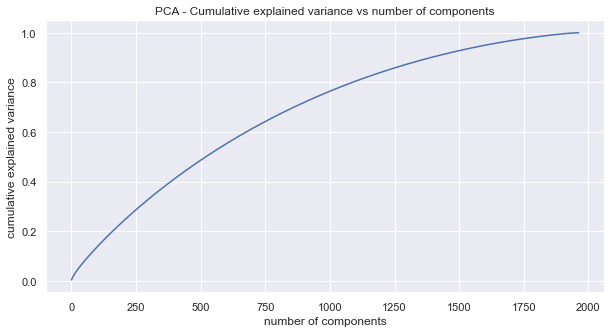

In [ ]:
pca = PCA(random_state=42)
pca.fit(X_std)
plt.figure(figsize=(10,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('PCA - Cumulative explained variance vs number of components')
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

In [ ]:
clusters = range(2, 40)

for cluster in clusters:
    
    print('---------------------------------')
    print('number of clusers = ', cluster)
    agg_cluster = AgglomerativeClustering(linkage="complete", 
                                        affinity='cosine',
                                        n_clusters=cluster)

    # Fit model

    clusters = agg_cluster.fit_predict(X_std)

    print("ARI score of linkage method complete cosine: {}".format(
        metrics.adjusted_rand_score(Y_int, clusters)))

    print("Silhouette score of linkage method complete cosine: {}".format(
        metrics.silhouette_score(X_std, clusters, metric='euclidean')))
    print("------------------------------------------------")

    # Defining the agglomerative clustering
    agg_cluster = AgglomerativeClustering(linkage="ward", 
                                        affinity='euclidean',
                                        n_clusters=cluster)

    # Fit model
    clusters = agg_cluster.fit_predict(X_std)

    print("ARI score of linkage method ward euclidean: {}".format(
        metrics.adjusted_rand_score(Y_int, clusters)))

    print("Silhouette score of linkage method ward euclidean: {}".format(
        metrics.silhouette_score(X_std, clusters, metric='euclidean')))

---------------------------------
number of clusers =  2
ARI score of linkage method complete cosine: 0.0
Silhouette score of linkage method complete cosine: -0.17108609770397643
------------------------------------------------
ARI score of linkage method ward euclidean: 0.0
Silhouette score of linkage method ward euclidean: 0.23519126865881004
---------------------------------
number of clusers =  3
ARI score of linkage method complete cosine: 0.0
Silhouette score of linkage method complete cosine: -0.20225400347514866
------------------------------------------------
ARI score of linkage method ward euclidean: 0.0
Silhouette score of linkage method ward euclidean: 0.18049284124341172
---------------------------------
number of clusers =  4
ARI score of linkage method complete cosine: 0.0
Silhouette score of linkage method complete cosine: -0.20208684425714993
------------------------------------------------
ARI score of linkage method ward euclidean: 0.0
Silhouette score of linkage me

In [ ]:
epsilon = range(1, 4, 1)
samples = range(2, 8, 1)

for eps in epsilon:
    
    # Epsilon number
    print('---------------------------------')
    print('Epsilon: {}'.format(str(eps)))

    for sample in samples:
    
        # Number of samples
        print('---------------------------------')
        print('Number of samples: {}'.format(str(sample)))

        # Define DBSCAN
        dbscan = DBSCAN(eps=eps, min_samples=sample)

        # Fit and predictions
        dbscan_predictions = dbscan.fit_predict(X_std)
        if len(np.unique(dbscan_predictions)) != 1: 
            score(X_std, dbscan_predictions)


---------------------------------
Epsilon: 1
---------------------------------
Number of samples: 2
Number of clusters in predictions: 24
Silhouette Score: -0.0974864597211755
---------------------------------
Number of samples: 3
Number of clusters in predictions: 6
Silhouette Score: -0.07379755054107856
---------------------------------
Number of samples: 4
Number of clusters in predictions: 2
Silhouette Score: 0.13362235878960674
---------------------------------
Number of samples: 5
---------------------------------
Number of samples: 6
---------------------------------
Number of samples: 7
---------------------------------
Epsilon: 2
---------------------------------
Number of samples: 2
Number of clusters in predictions: 24
Silhouette Score: -0.0974864597211755
---------------------------------
Number of samples: 3
Number of clusters in predictions: 6
Silhouette Score: -0.07379755054107856
---------------------------------
Number of samples: 4
Number of clusters in predictions: 2

In [ ]:
clusters = range(2, 40)

for cluster in clusters:
    
    print('---------------------------------')

    # Define KMeans
    kmeans = KMeans(n_clusters=cluster, random_state=42)

    # Fit model
    kmeans.fit(X_std)

    # Predictions
    kmeans_predictions = kmeans.predict(X_std)

    # Metrics
    score(X_std, kmeans_predictions)


---------------------------------
Number of clusters in predictions: 2
Silhouette Score: 0.21339056984673008
---------------------------------
Number of clusters in predictions: 3
Silhouette Score: 0.12879747468200023
---------------------------------
Number of clusters in predictions: 4
Silhouette Score: 0.0029630255255309957
---------------------------------
Number of clusters in predictions: 5
Silhouette Score: 0.044350543278247834
---------------------------------
Number of clusters in predictions: 6
Silhouette Score: -0.01568613407430106
---------------------------------
Number of clusters in predictions: 7
Silhouette Score: 0.014672573057273739
---------------------------------
Number of clusters in predictions: 8
Silhouette Score: -0.011168751728721461
---------------------------------
Number of clusters in predictions: 9
Silhouette Score: -0.010553034234996601
---------------------------------
Number of clusters in predictions: 10
Silhouette Score: -0.009724767011065323
-------